In [1]:
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage import feature, transform

from hpi.dataloader import DeepZoom, NDP
from hpi.crop import generate_config, update_config, _show_guide, _crop
from hpi.dataloader.io import load_ndpi, load_ndpa
from hpi.random import sample
from eda._git import git_root

In [2]:
ROOT = git_root(absolute=True)
output_dir_parent = Path(f"{ROOT}/data/submission/cropped/human/liver")
meta = pd.read_csv(f"{ROOT}/database/summary.csv")
meta["Date added"] = pd.to_datetime(meta["Date added"])
meta

,Date added,Image,Annotation,Owner,Species,Directory,S3,Description
0,2021-09-10,16AI5_2021-04-05_12.20.39(1).ndpi,16AI5_2021-04-05_12.20.39(1).ndpi.ndpa,Aimono,mouse,data/raw/16AI5_2021-04-05_12.20.39(1),NaN,Merged ndpa of the two below.
1,2021-09-10,16AI5_2021-04-05_12.20.39(1).ndpi,16AI5_2021-04-05_12.20.39(1)_01.ndpi.ndpa,Aimono,mouse,data/raw/16AI5_2021-04-05_12.20.39(1),s3://temporary-data-saya-lab-keio/renamed/aimo...,NaN
2,2021-09-10,16AI5_2021-04-05_12.20.39(1).ndpi,16AI5_2021-04-05_12.20.39(1)_02.ndpi.ndpa,Aimono,mouse,data/raw/16AI5_2021-04-05_12.20.39(1),s3://temporary-data-saya-lab-keio/renamed/aimo...,NaN
3,2021-11-16,TA2620_5_5_2021-11-16_11.34.46,NaN,Aimono,Human,data/raw/TA2620_5_5_2021-11-16_11.34.46,s3://temporary-data-saya-lab-keio/renamed/aimo...,NaN


In [3]:
ndp_dir = ROOT / meta.iloc[-1]["Directory"]
img_name = "TA2620_5_5_2021-11-16_11.34.46"
size = 32
init_level = 11
target_levels = [14, 15, 16]

0.44193035177656004 0.44193035177656004
CPU times: user 7.48 s, sys: 948 ms, total: 8.43 s
Wall time: 8.54 s


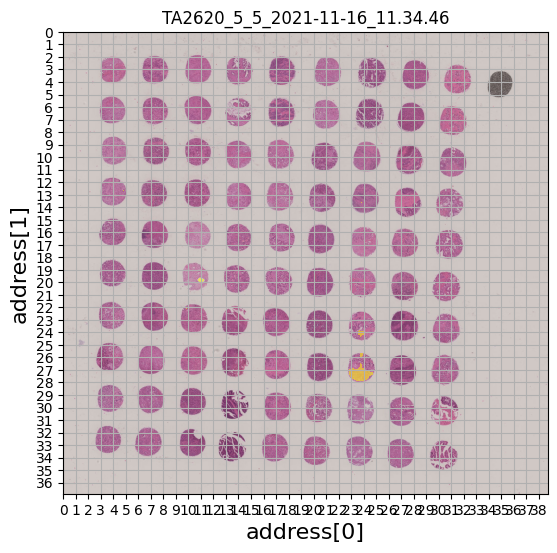

In [4]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)
print(ndpi.x_mpp, ndpi.y_mpp)

1列目

In [5]:
dz.info()


===openslide.slide object===
level dimensions	: ((38400, 36608), (19200, 18304), (9600, 9152), (4800, 4576), (2400, 2288), (1200, 1144), (600, 572), (300, 286), (150, 143))

===openslide.deepzoom.DeepZoomGenerator object===
level count		: 17
tile count		: 1830494
level tiles		: ((1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (2, 2), (3, 3), (5, 5), (10, 9), (19, 18), (38, 36), (75, 72), (150, 143), (300, 286), (600, 572), (1200, 1144))
level dimensions	: ((1, 1), (2, 2), (3, 3), (5, 5), (10, 9), (19, 18), (38, 36), (75, 72), (150, 143), (300, 286), (600, 572), (1200, 1144), (2400, 2288), (4800, 4576), (9600, 9152), (19200, 18304), (38400, 36608))
get dzi			: <Image TileSize="32" Overlap="1" Format="png" xmlns="http://schemas.microsoft.com/deepzoom/2008"><Size Width="38400" Height="36608" /></Image>


img: 0.00 GB


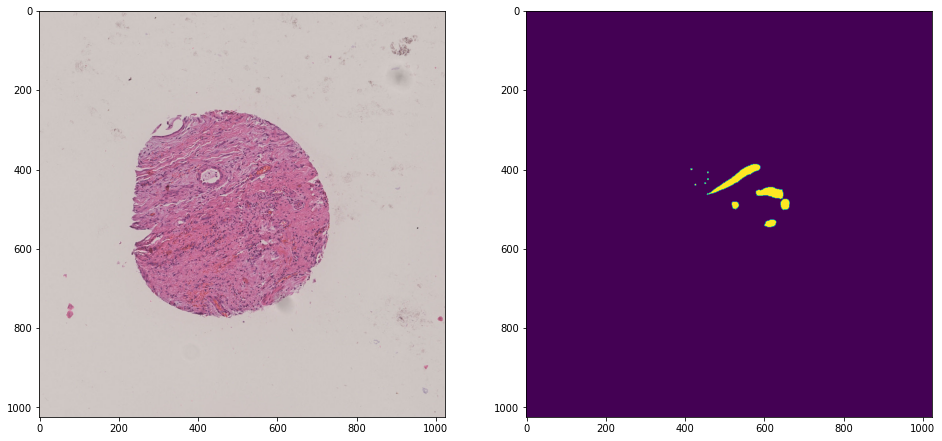

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 14.8 s, total: 49.6 s
Wall time: 1min 3s


In [6]:
%%time
index = 0
config.update(dict(addresses=[(2, 1), (6, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


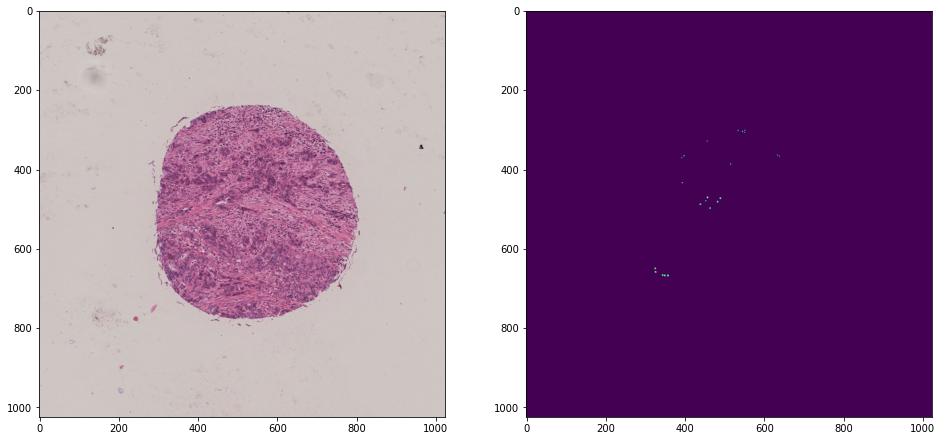

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 15.8 s, total: 49.7 s
Wall time: 50.7 s


In [7]:
%%time
index += 1
config.update(dict(addresses=[(5, 1), (9, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


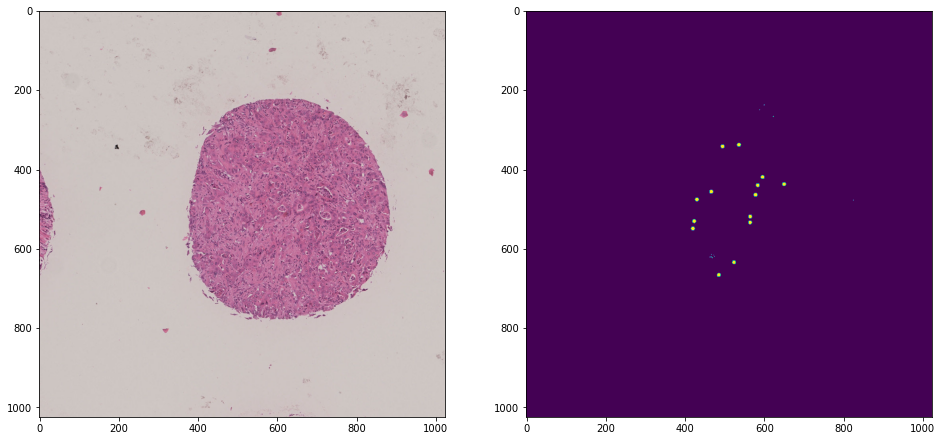

img: 0.02 GB
img: 0.07 GB
CPU times: user 39 s, sys: 15 s, total: 54 s
Wall time: 54.9 s


In [8]:
%%time
index += 1
config.update(dict(addresses=[(8, 1), (12, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


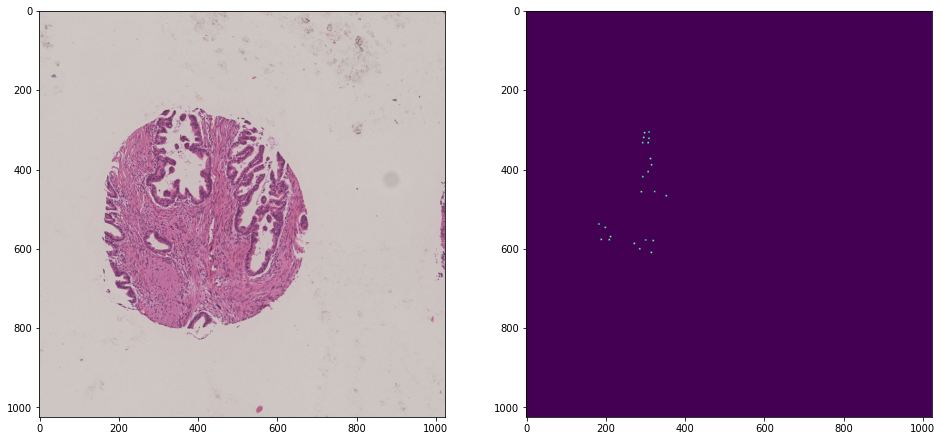

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 13.6 s, total: 48.1 s
Wall time: 48.7 s


In [9]:
%%time
index += 1
config.update(dict(addresses=[(12, 1), (16, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


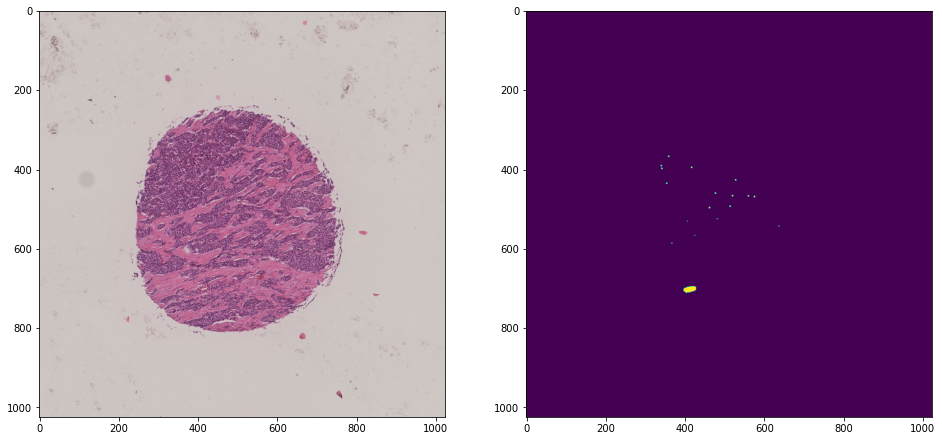

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 14.8 s, total: 48.7 s
Wall time: 49.3 s


In [10]:
%%time
index += 1
config.update(dict(addresses=[(15, 1), (19, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


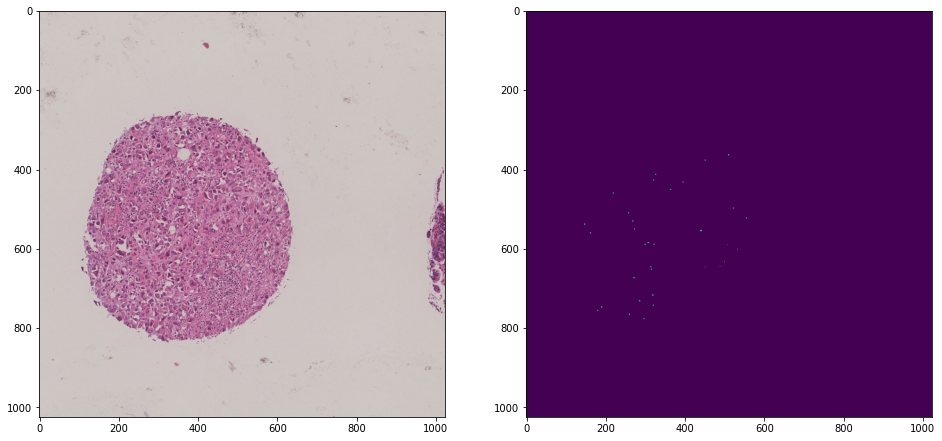

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 8.31 s, total: 42.2 s
Wall time: 43.1 s


In [11]:
%%time
index += 1
config.update(dict(addresses=[(19, 1), (23, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


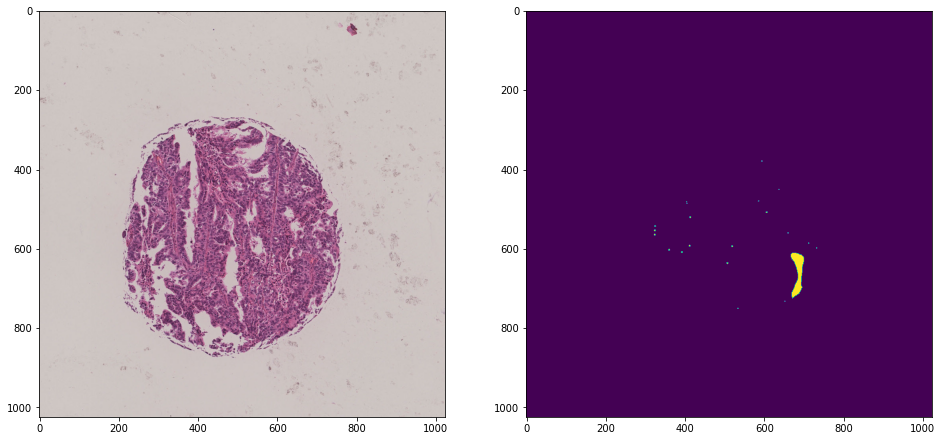

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 11.3 s, total: 45.4 s
Wall time: 46.1 s


In [12]:
%%time
index += 1
config.update(dict(addresses=[(22, 1), (26, 5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


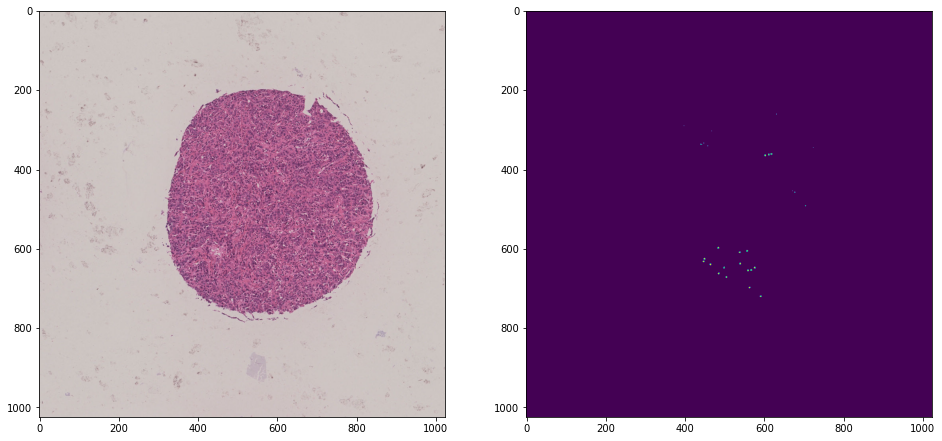

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 13.5 s, total: 47.5 s
Wall time: 49.2 s


In [13]:
%%time
index += 1
config.update(dict(addresses=[(25, 1.5), (29, 5.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


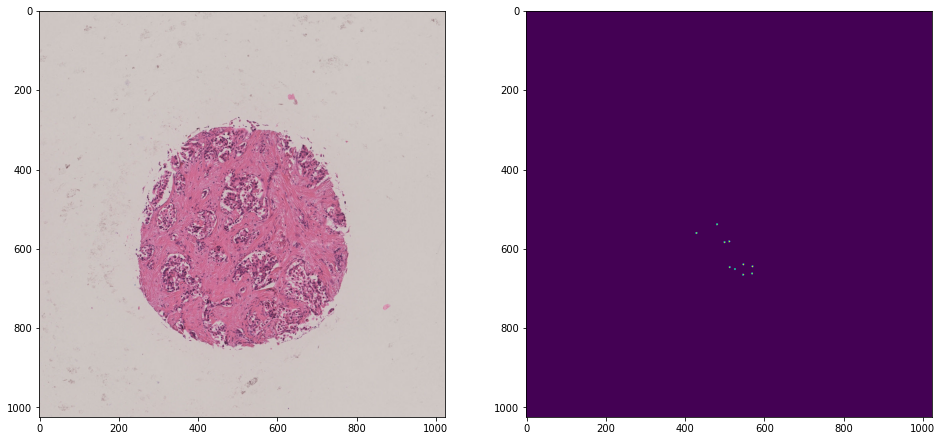

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 10.1 s, total: 44.4 s
Wall time: 45.2 s


In [14]:
%%time
index += 1
config.update(dict(addresses=[(28.5, 1.5), (32.5, 5.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---

２列目 

CPU times: user 7.68 s, sys: 5.64 s, total: 13.3 s
Wall time: 13.4 s


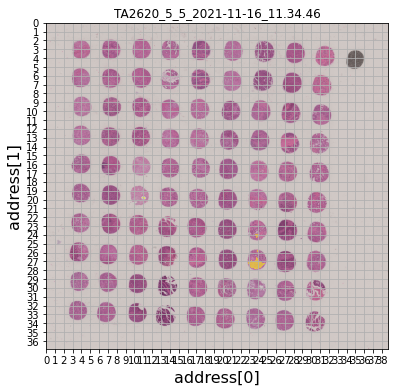

In [15]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


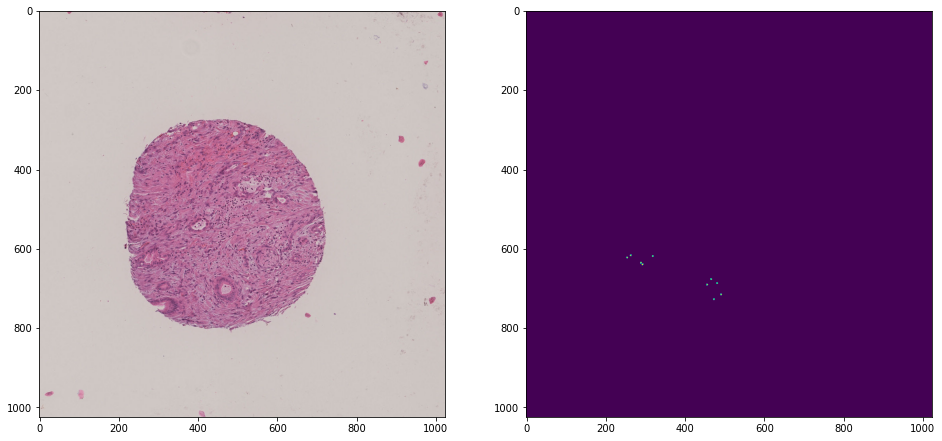

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 11.8 s, total: 46.1 s
Wall time: 57.6 s


In [16]:
%%time
index += 1
config.update(dict(addresses=[(2, 4), (6, 8)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


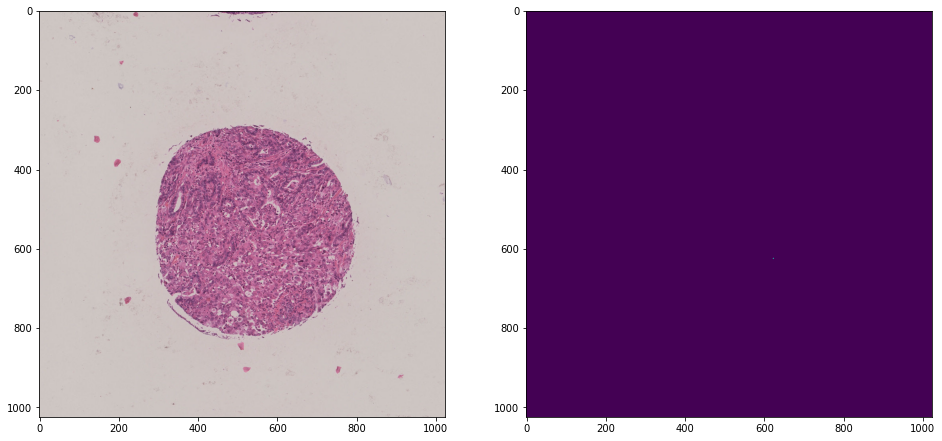

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 10.4 s, total: 45.1 s
Wall time: 45.9 s


In [17]:
%%time
index += 1
config.update(dict(addresses=[(5, 4), (9, 8)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


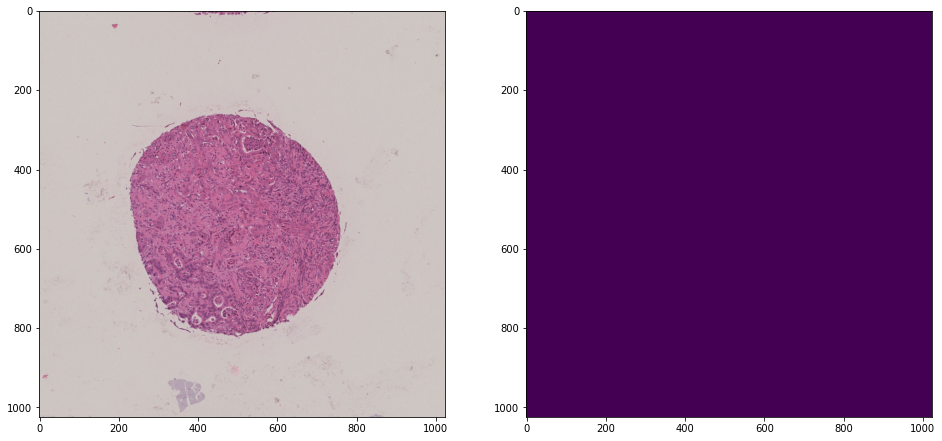

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.8 s, sys: 12.3 s, total: 47.1 s
Wall time: 47.9 s


In [18]:
%%time
index += 1
config.update(dict(addresses=[(8.5, 4), (12.5, 8)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


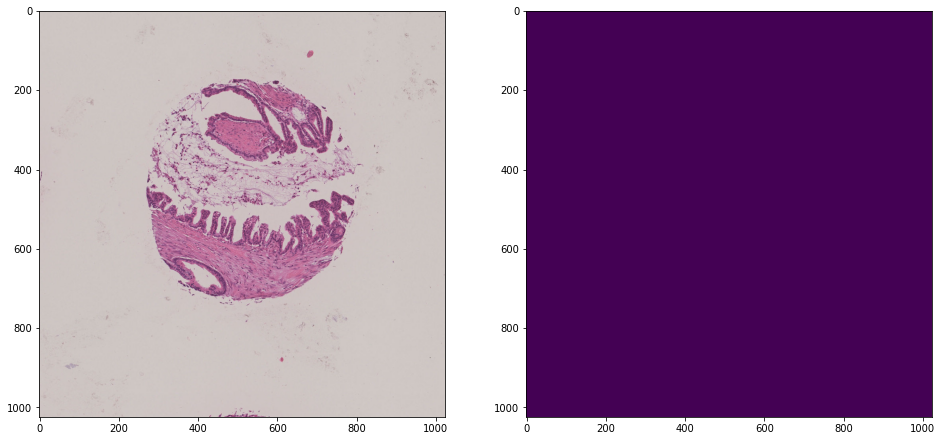

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.6 s, sys: 11.6 s, total: 45.2 s
Wall time: 48.8 s


In [19]:
%%time
index += 1
config.update(dict(addresses=[(11.5, 4.5), (15.5, 8.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


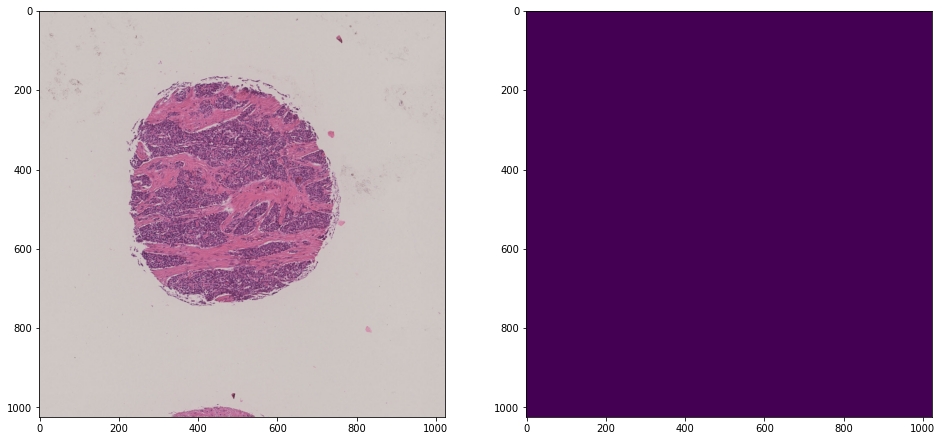

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.2 s, sys: 14.1 s, total: 48.3 s
Wall time: 49.4 s


In [20]:
%%time
index += 1
config.update(dict(addresses=[(15, 4.5), (19, 8.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


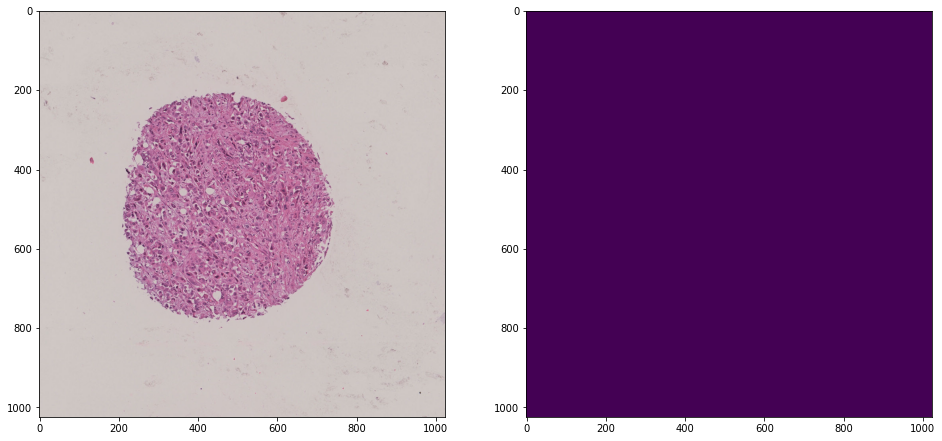

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 17.1 s, total: 51.7 s
Wall time: 52.4 s


In [21]:
%%time
index += 1
config.update(dict(addresses=[(18.5, 4.5), (22.5, 8.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


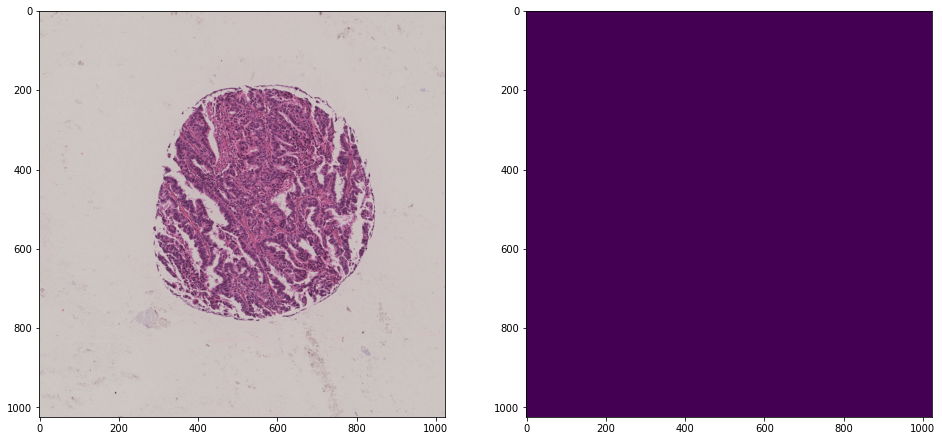

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 13.5 s, total: 47.6 s
Wall time: 48.4 s


In [22]:
%%time
index += 1
config.update(dict(addresses=[(21.5, 4.5), (25.5, 8.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


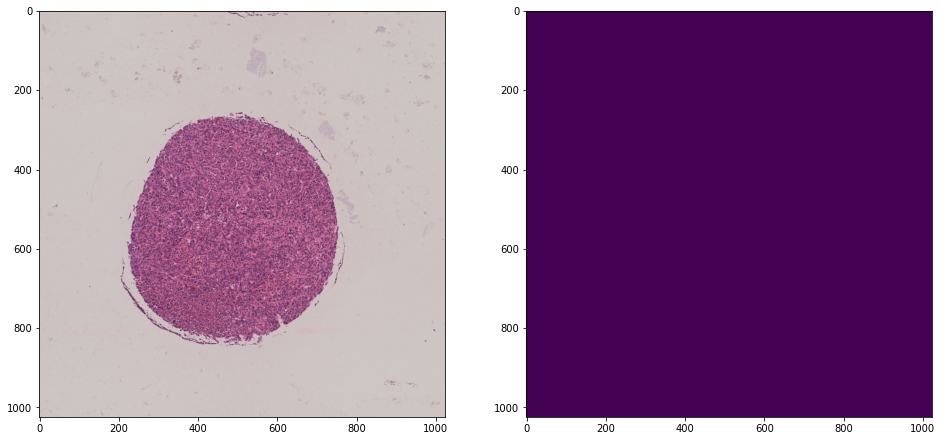

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 9.95 s, total: 44 s
Wall time: 44.5 s


In [23]:
%%time
index += 1
config.update(dict(addresses=[(25, 4.5), (29, 8.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


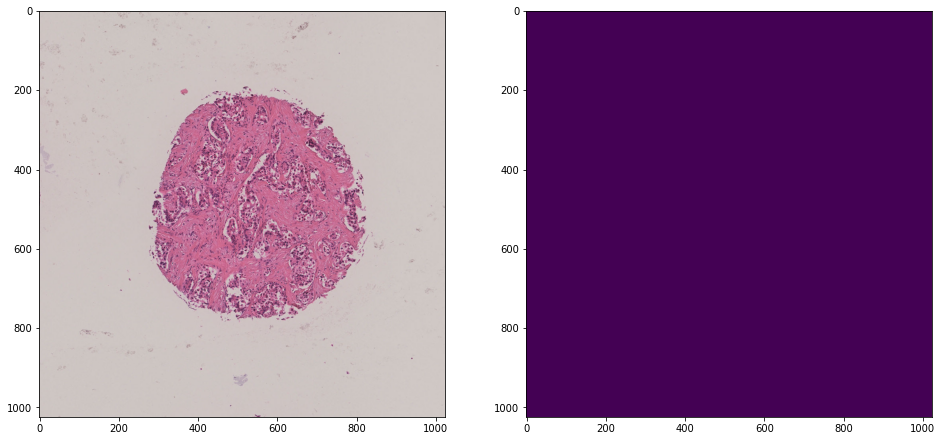

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.5 s, sys: 10.5 s, total: 44.9 s
Wall time: 47.2 s


In [24]:
%%time
index += 1
config.update(dict(addresses=[(28, 5), (32, 9)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---

3列目

CPU times: user 7.46 s, sys: 5.6 s, total: 13.1 s
Wall time: 13.1 s


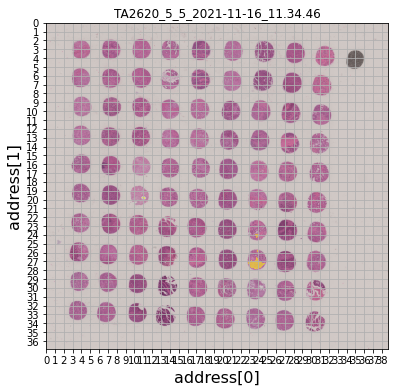

In [25]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


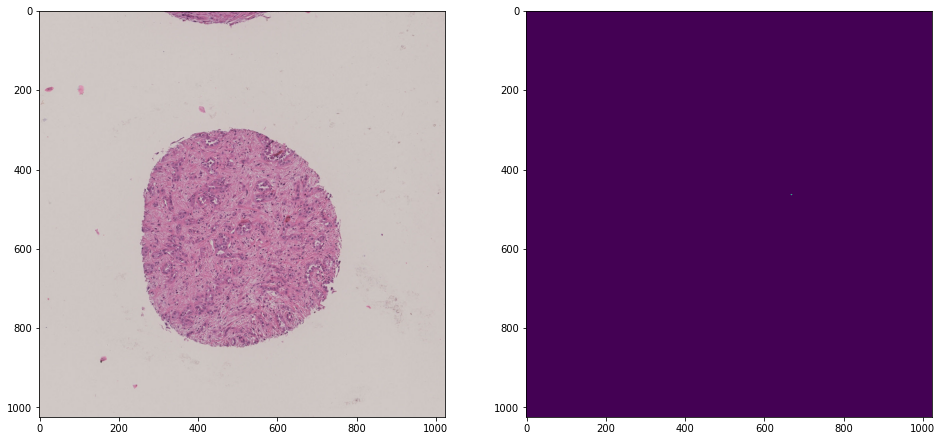

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 11.1 s, total: 45.1 s
Wall time: 55.3 s


In [26]:
%%time
index += 1
config.update(dict(addresses=[(2, 7), (6, 11)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


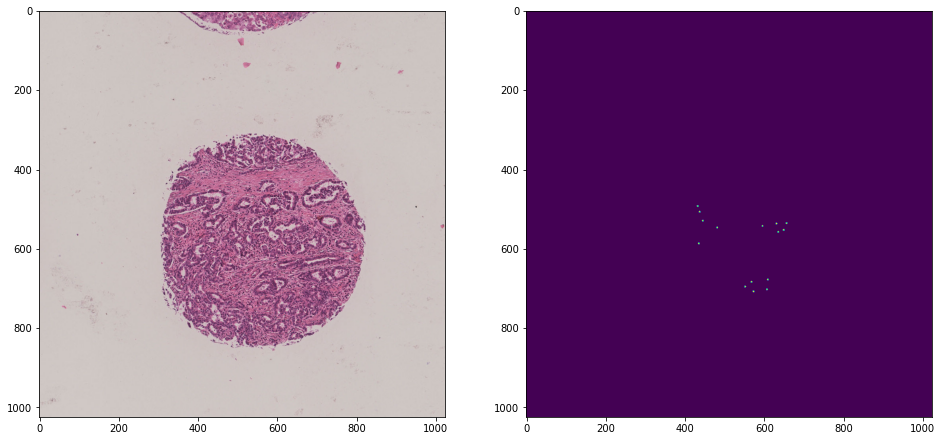

img: 0.02 GB
img: 0.07 GB
CPU times: user 35 s, sys: 17.6 s, total: 52.6 s
Wall time: 53.6 s


In [27]:
%%time
index += 1
config.update(dict(addresses=[(5, 7), (9, 11)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


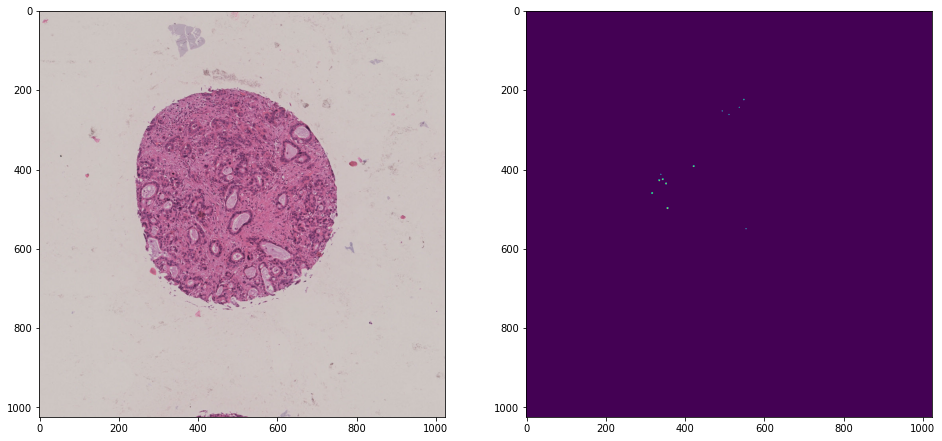

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.2 s, sys: 8.96 s, total: 43.2 s
Wall time: 45.6 s


In [28]:
%%time
index += 1
config.update(dict(addresses=[(8.5, 7.5), (12.5, 11.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


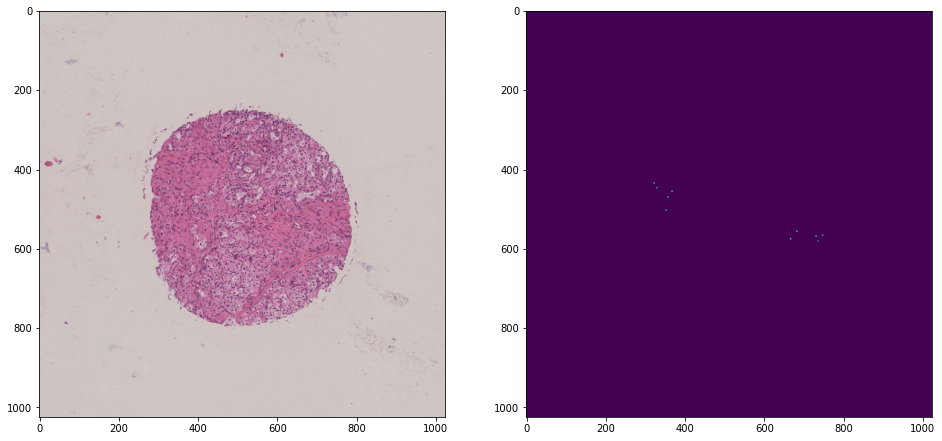

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 17.3 s, total: 51.7 s
Wall time: 52.6 s


In [29]:
%%time
index += 1
config.update(dict(addresses=[(11.5, 7.5), (15.5, 11.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


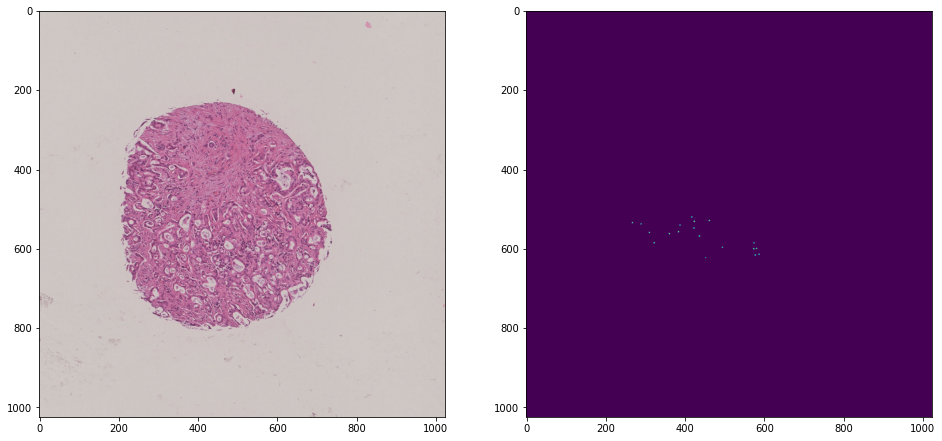

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 11.4 s, total: 46.1 s
Wall time: 47 s


In [30]:
%%time
index += 1
config.update(dict(addresses=[(15, 7.5), (19, 11.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


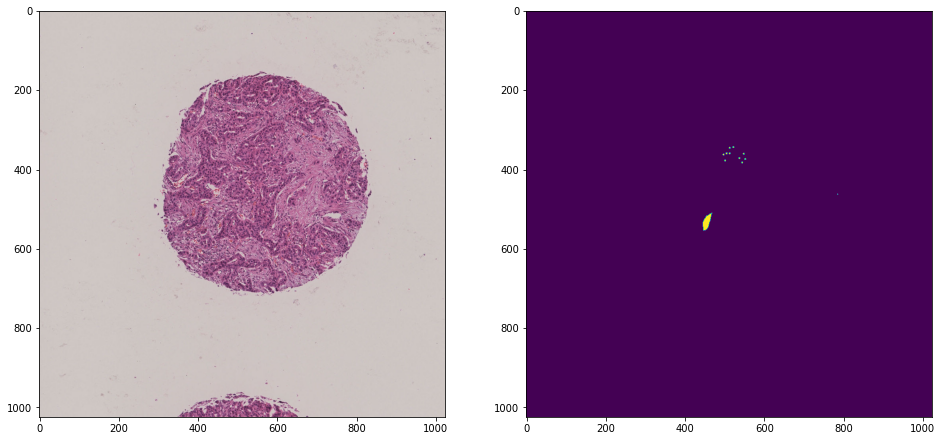

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 19.7 s, total: 54.5 s
Wall time: 56.5 s


In [31]:
%%time
index += 1
config.update(dict(addresses=[(18, 8), (22, 12)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


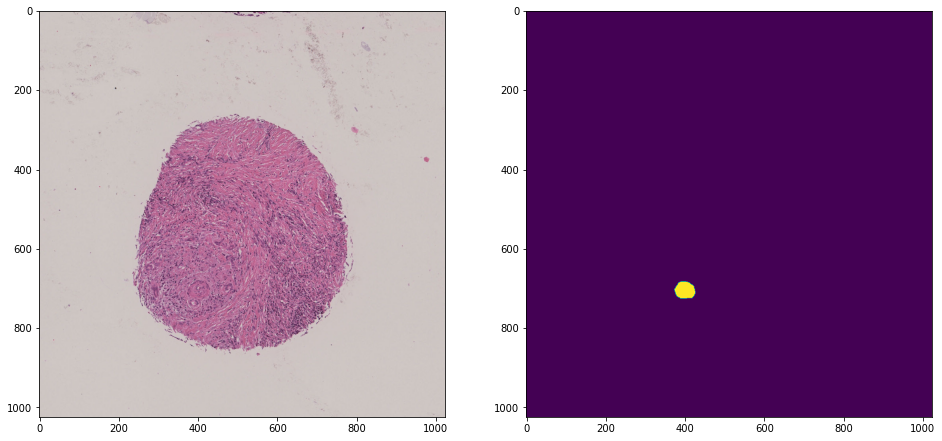

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 9.49 s, total: 43.9 s
Wall time: 44.4 s


In [32]:
%%time
index += 1
config.update(dict(addresses=[(21.5, 7.5), (25.5, 11.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


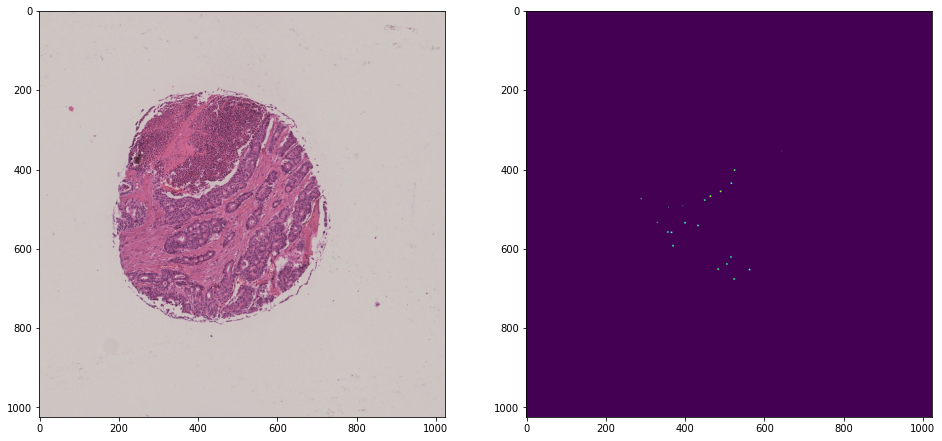

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 10.5 s, total: 44.9 s
Wall time: 45.4 s


In [33]:
%%time
index += 1
config.update(dict(addresses=[(25, 8), (29, 12)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


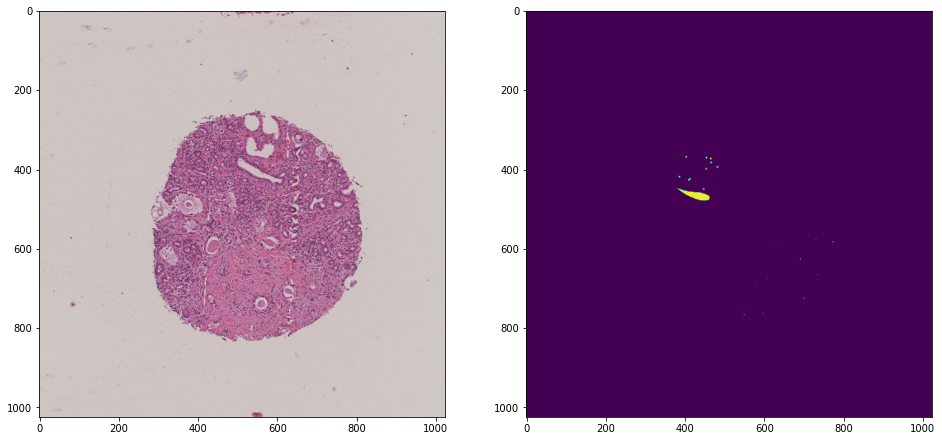

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 12.8 s, total: 46.8 s
Wall time: 47.8 s


In [34]:
%%time
index += 1
config.update(dict(addresses=[(28, 8), (32, 12)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
４列目

CPU times: user 7.62 s, sys: 5.55 s, total: 13.2 s
Wall time: 13.3 s


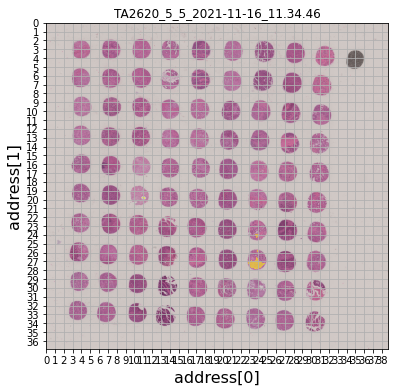

In [35]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


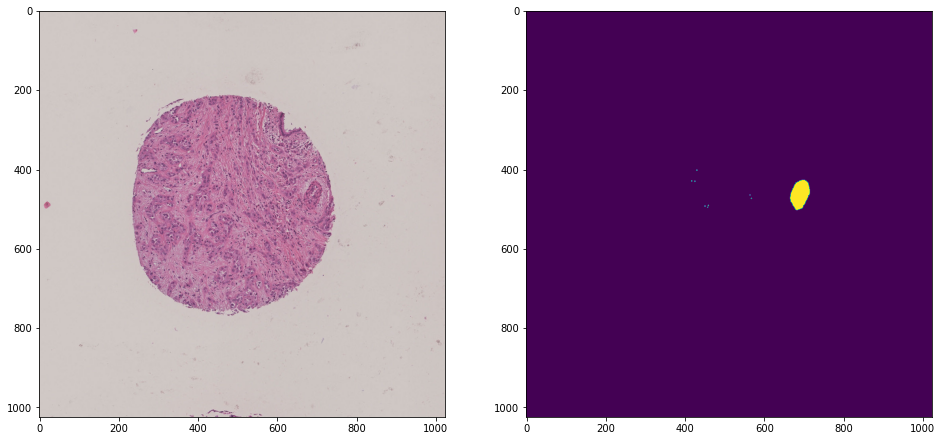

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.5 s, sys: 13.5 s, total: 47.9 s
Wall time: 59.7 s


In [36]:
%%time
index += 1
config.update(dict(addresses=[(2, 10.5), (6, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


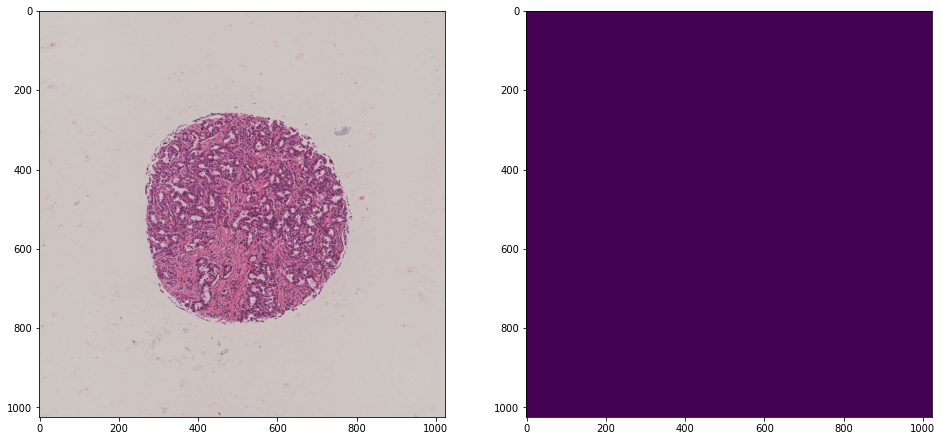

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 14.4 s, total: 48.4 s
Wall time: 48.9 s


In [37]:
%%time
index += 1
config.update(dict(addresses=[(5, 10.5), (9, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


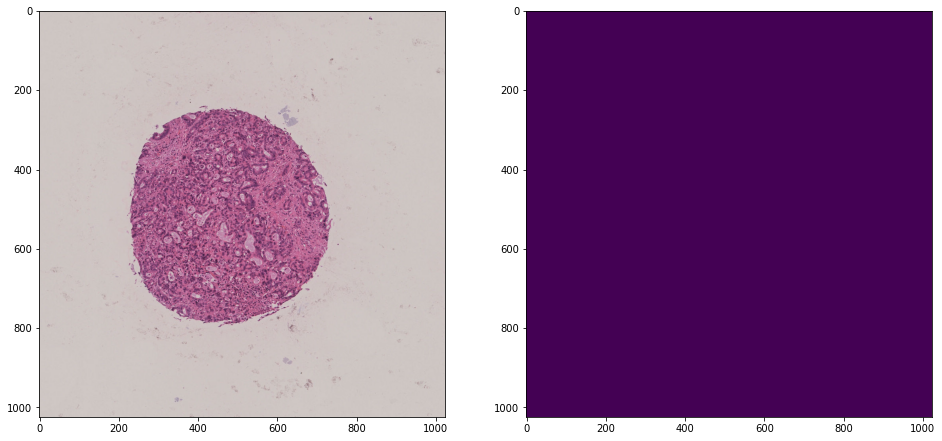

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.8 s, sys: 9.81 s, total: 43.6 s
Wall time: 44.2 s


In [38]:
%%time
index += 1
config.update(dict(addresses=[(8.5, 10.5), (12.5, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


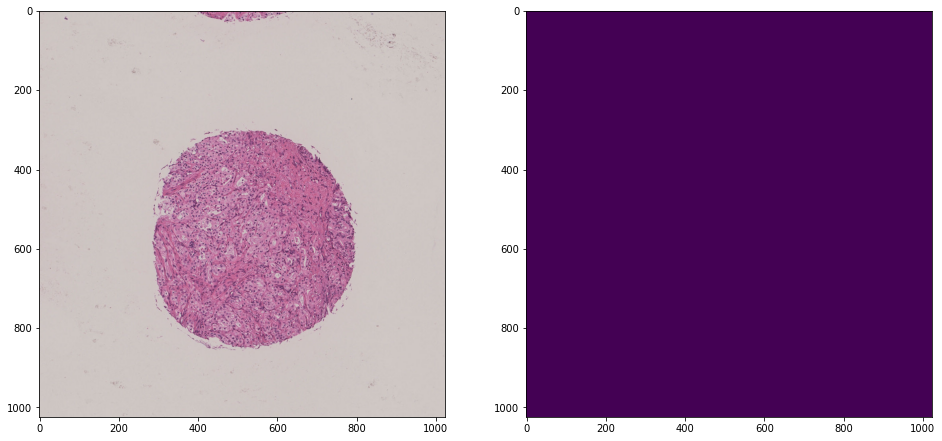

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 9.4 s, total: 43.3 s
Wall time: 44.6 s


In [39]:
%%time
index += 1
config.update(dict(addresses=[(11.5, 10.5), (15.5, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


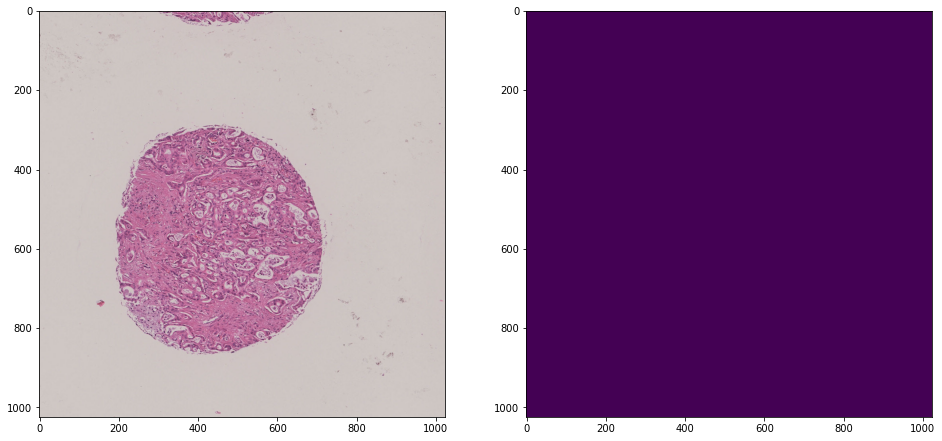

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 12.7 s, total: 46.9 s
Wall time: 47.5 s


In [40]:
%%time
index += 1
config.update(dict(addresses=[(15, 10.5), (19, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


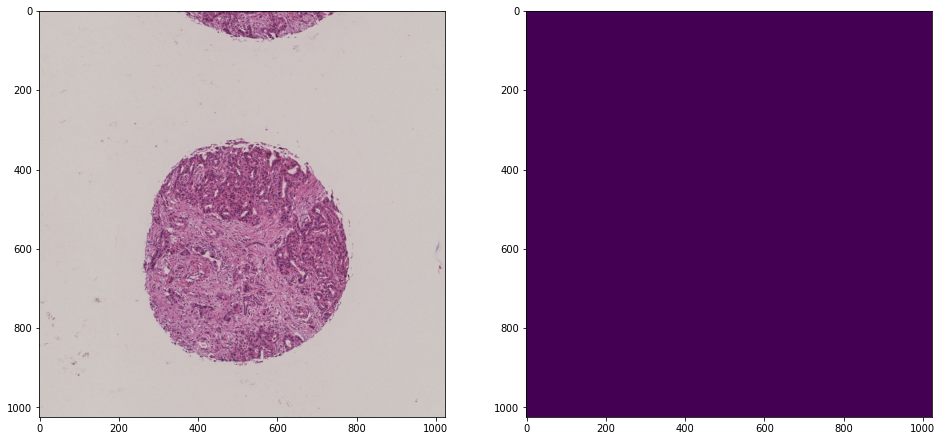

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 10.9 s, total: 45.5 s
Wall time: 46 s


In [41]:
%%time
index += 1
config.update(dict(addresses=[(18, 10.5), (22, 14.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


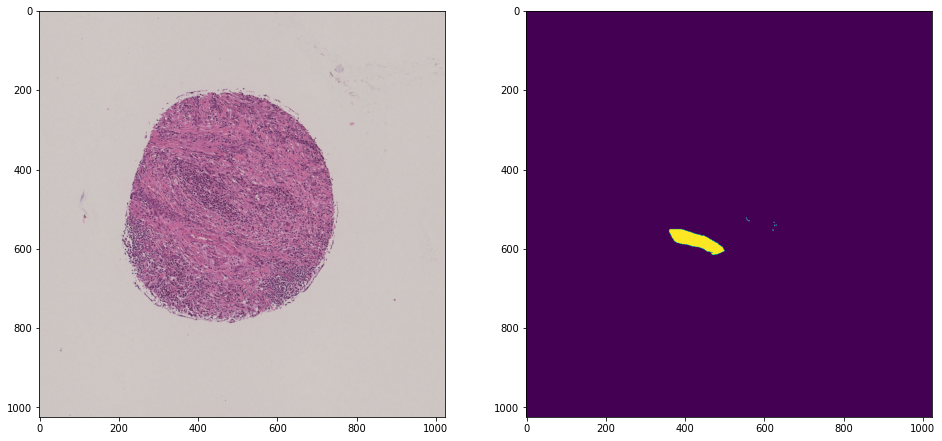

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.8 s, sys: 12.3 s, total: 47.1 s
Wall time: 50.8 s


In [42]:
%%time
index += 1
config.update(dict(addresses=[(21.5, 11), (25.5, 15)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


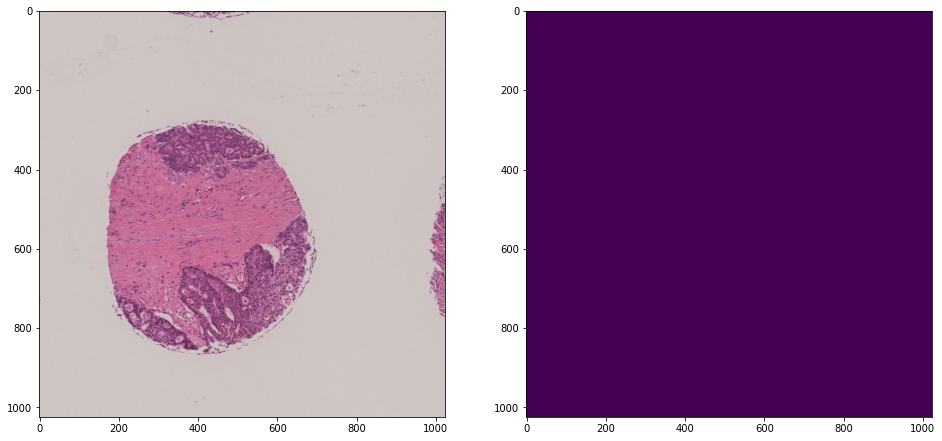

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 11.4 s, total: 45.7 s
Wall time: 46.4 s


In [43]:
%%time
index += 1
config.update(dict(addresses=[(25, 11), (29, 15)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


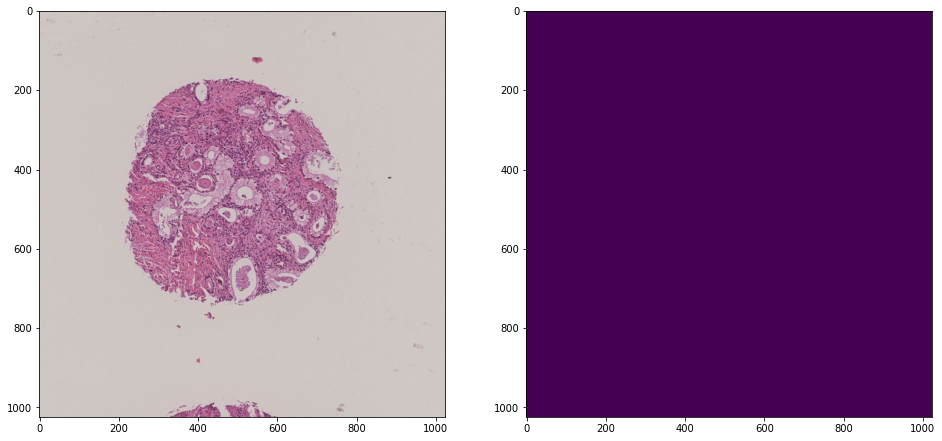

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 11.4 s, total: 46.2 s
Wall time: 48.8 s


In [44]:
%%time
index += 1
config.update(dict(addresses=[(28, 11.5), (32, 15.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
５行目

CPU times: user 7.56 s, sys: 6.11 s, total: 13.7 s
Wall time: 13.8 s


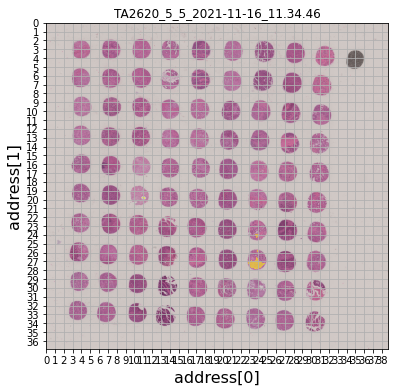

In [45]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


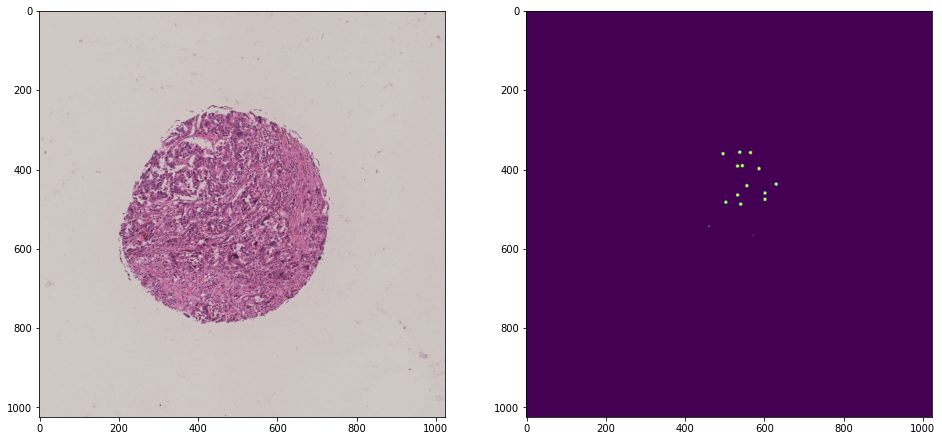

img: 0.02 GB
img: 0.07 GB
CPU times: user 37.3 s, sys: 8.64 s, total: 45.9 s
Wall time: 54 s


In [46]:
%%time
index += 1
config.update(dict(addresses=[(2, 13.5), (6, 17.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


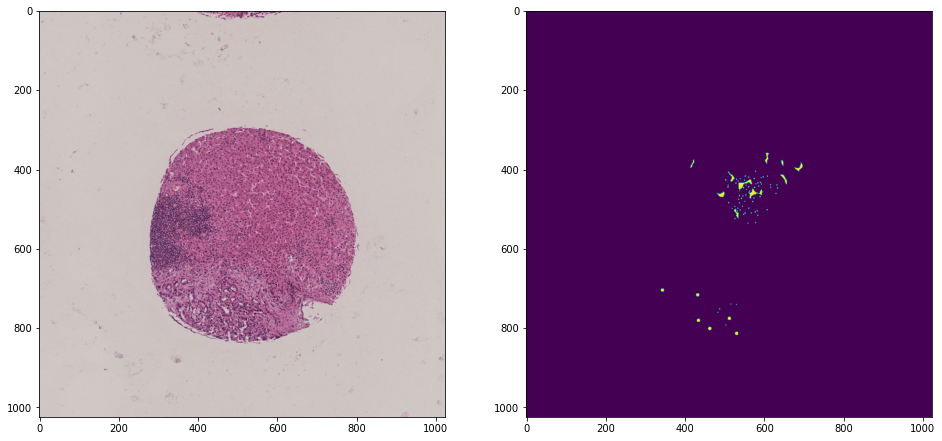

img: 0.02 GB
img: 0.07 GB
CPU times: user 35.9 s, sys: 11.8 s, total: 47.6 s
Wall time: 48.2 s


In [47]:
%%time
index += 1
config.update(dict(addresses=[(5, 13.5), (9, 17.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


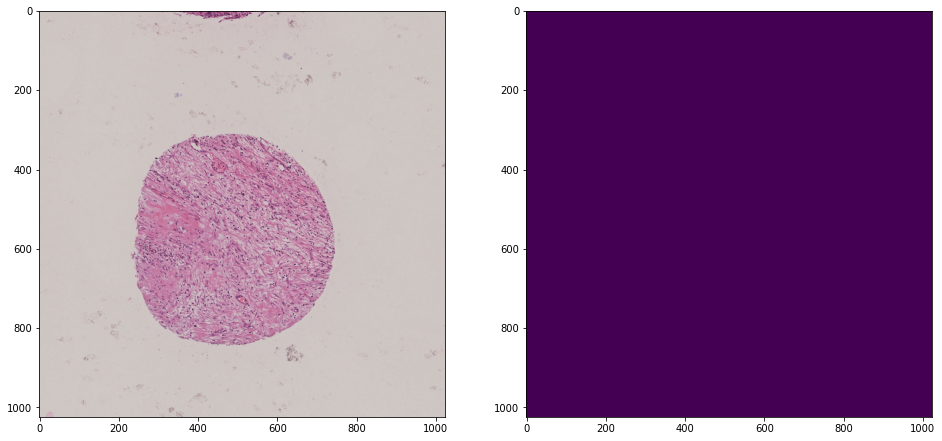

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.6 s, sys: 7.13 s, total: 40.7 s
Wall time: 41.1 s


In [48]:
%%time
index += 1
config.update(dict(addresses=[(8.5, 13.5), (12.5, 17.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


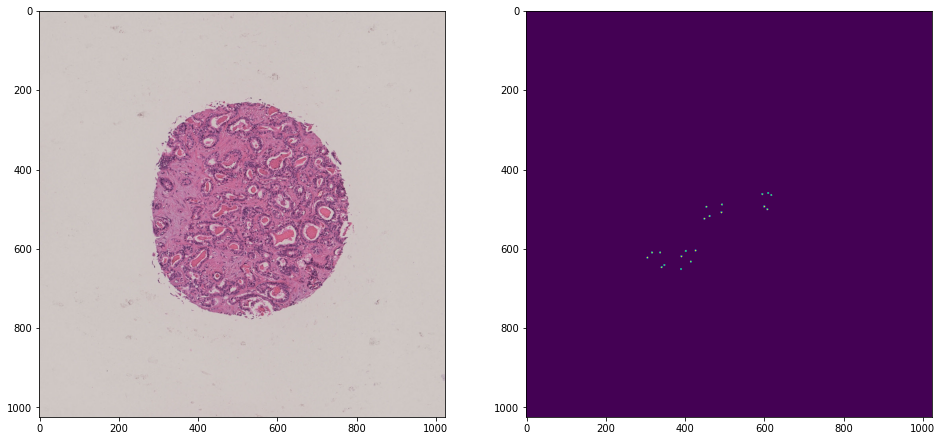

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 12 s, total: 46.2 s
Wall time: 50.5 s


In [49]:
%%time
index += 1
config.update(dict(addresses=[(11.5, 14), (15.5, 18)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


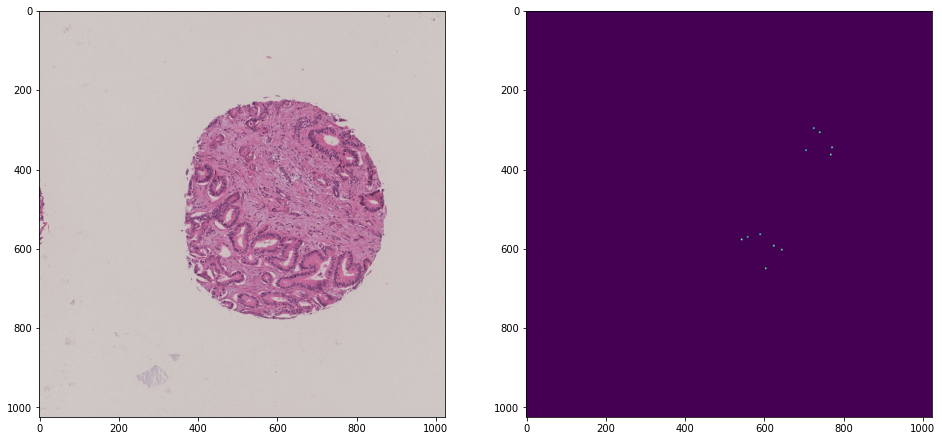

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.9 s, sys: 15.3 s, total: 50.3 s
Wall time: 51.2 s


In [50]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 14), (18.5, 18)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


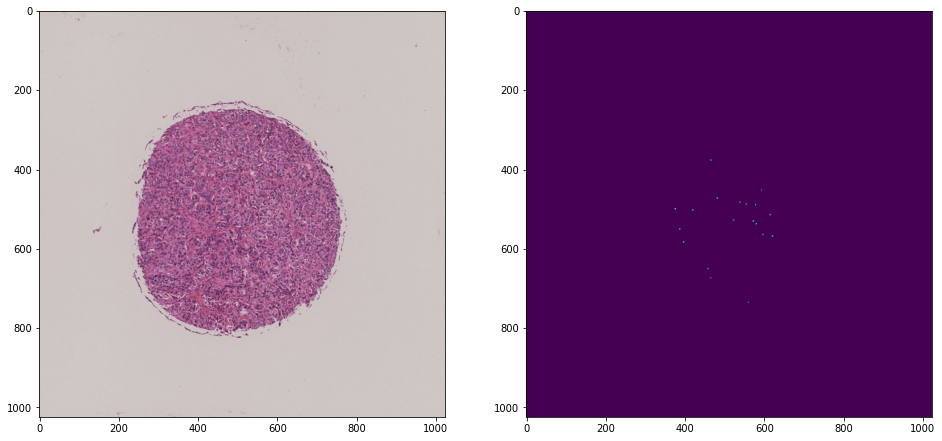

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 10.2 s, total: 44.9 s
Wall time: 45.5 s


In [51]:
%%time
index += 1
config.update(dict(addresses=[(18, 14), (22, 18)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


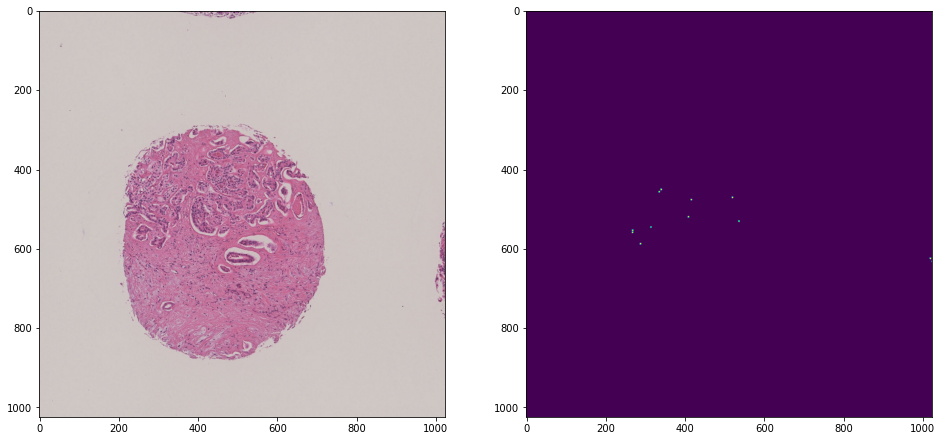

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 11 s, total: 45.4 s
Wall time: 45.9 s


In [52]:
%%time
index += 1
config.update(dict(addresses=[(21.5, 14), (25.5, 18)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


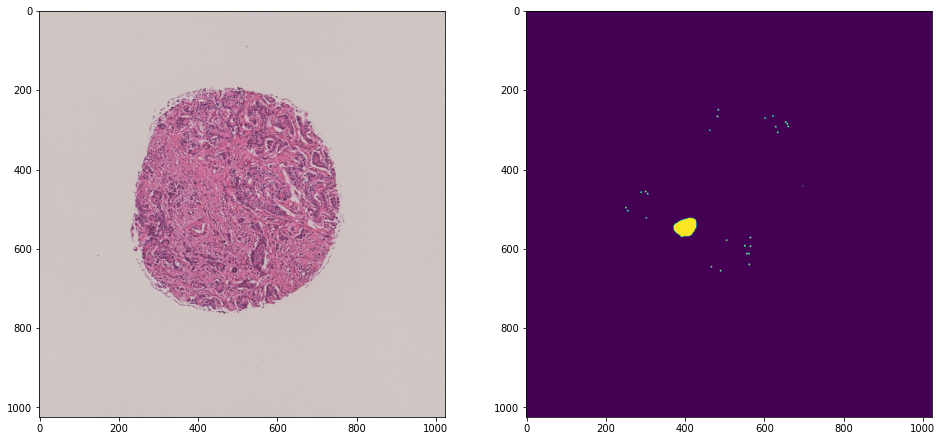

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.5 s, sys: 13.8 s, total: 48.2 s
Wall time: 51 s


In [53]:
%%time
index += 1
config.update(dict(addresses=[(24.5, 14.5), (28.5, 18.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


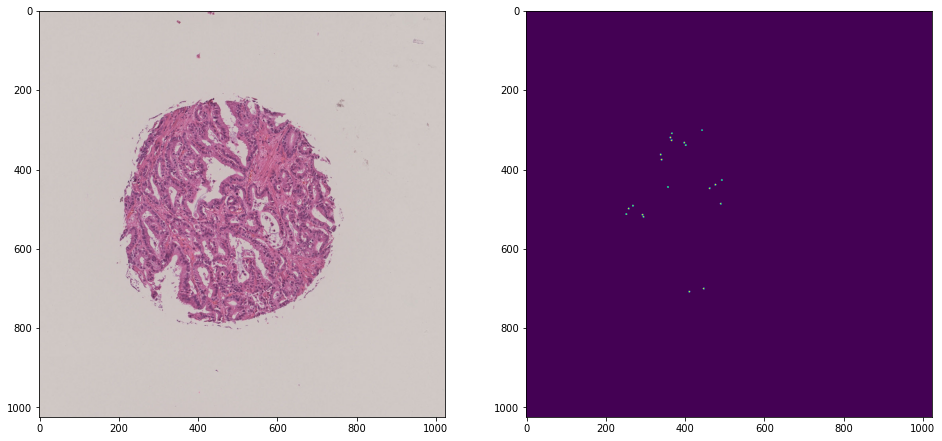

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 5.87 s, total: 40.2 s
Wall time: 41.2 s


In [54]:
%%time
index += 1
config.update(dict(addresses=[(28, 14.5), (32, 18.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
6行目

CPU times: user 7.91 s, sys: 5.14 s, total: 13 s
Wall time: 13.2 s


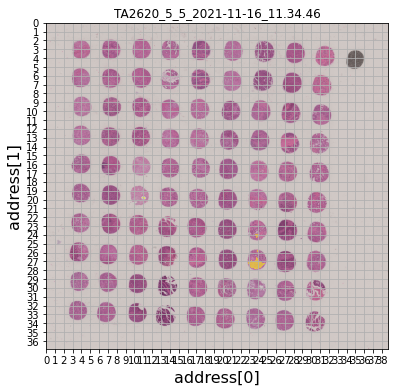

In [55]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


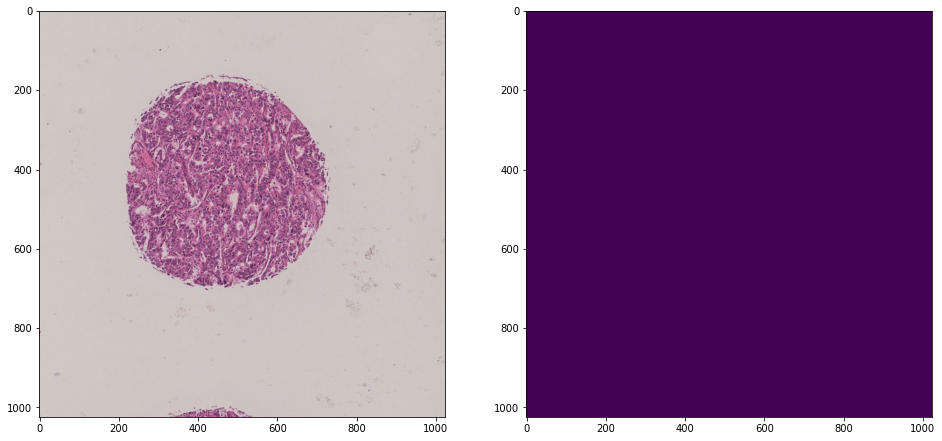

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 6.47 s, total: 40.9 s
Wall time: 52 s


In [56]:
%%time
index += 1
config.update(dict(addresses=[(2, 17), (6, 21)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


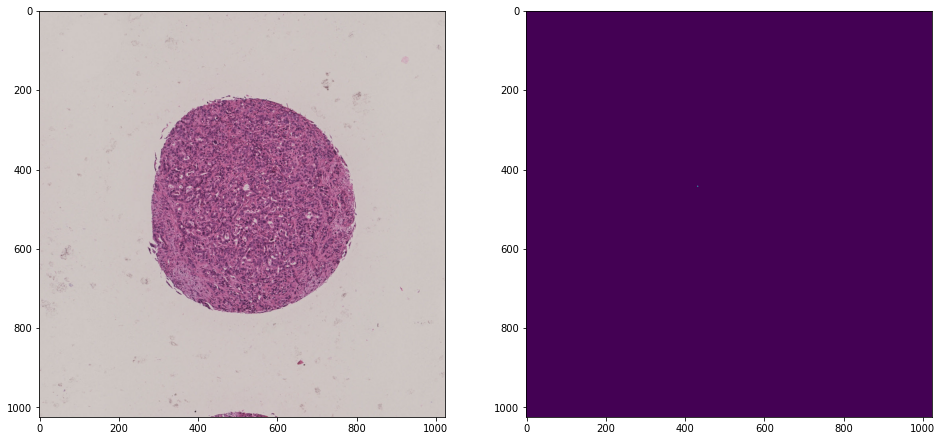

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 15.3 s, total: 49.3 s
Wall time: 49.8 s


In [57]:
%%time
index += 1
config.update(dict(addresses=[(5, 17), (9, 21)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


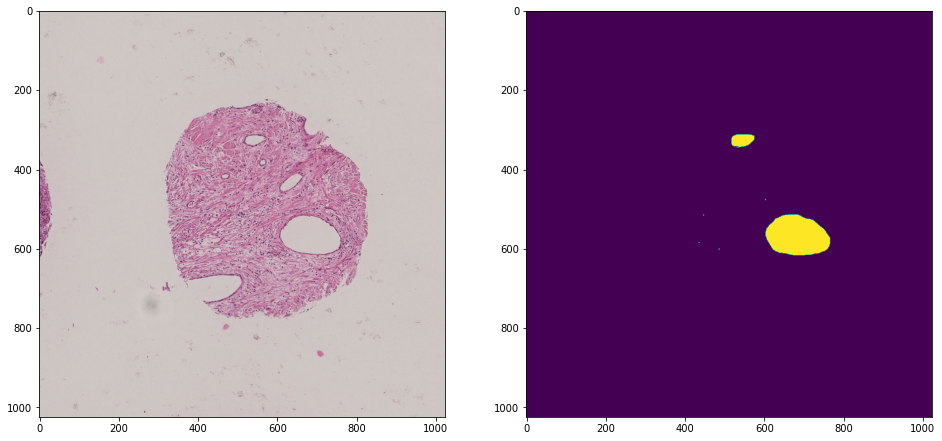

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 14 s, total: 48.6 s
Wall time: 49.8 s


In [58]:
%%time
index += 1
config.update(dict(addresses=[(8, 17), (12, 21)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


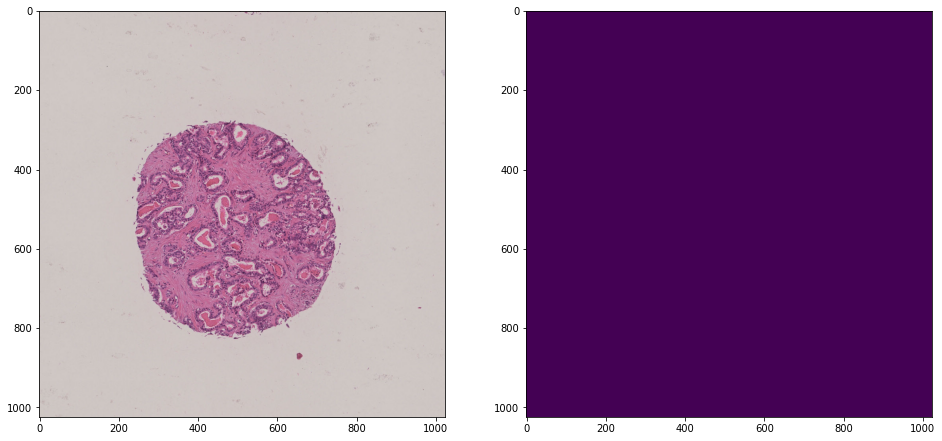

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 5.06 s, total: 39 s
Wall time: 39.8 s


In [59]:
%%time
index += 1
config.update(dict(addresses=[(11.5, 17), (15.5, 21)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


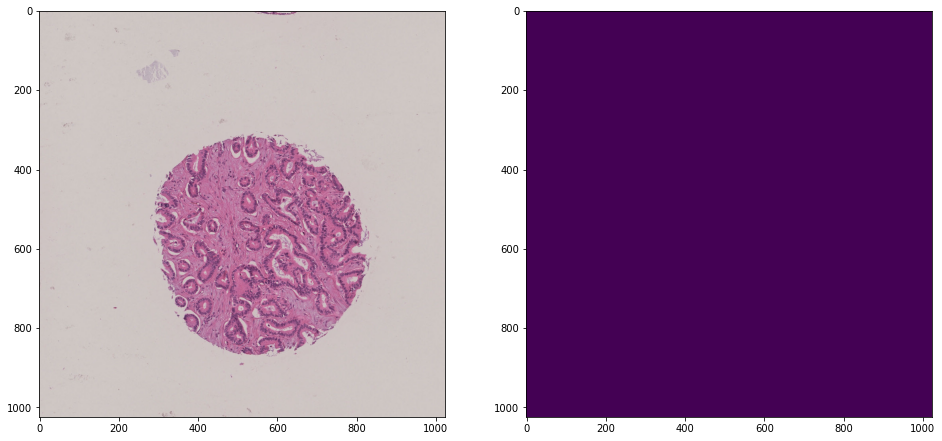

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 12.1 s, total: 46.5 s
Wall time: 47.4 s


In [60]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 17), (18.5, 21)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


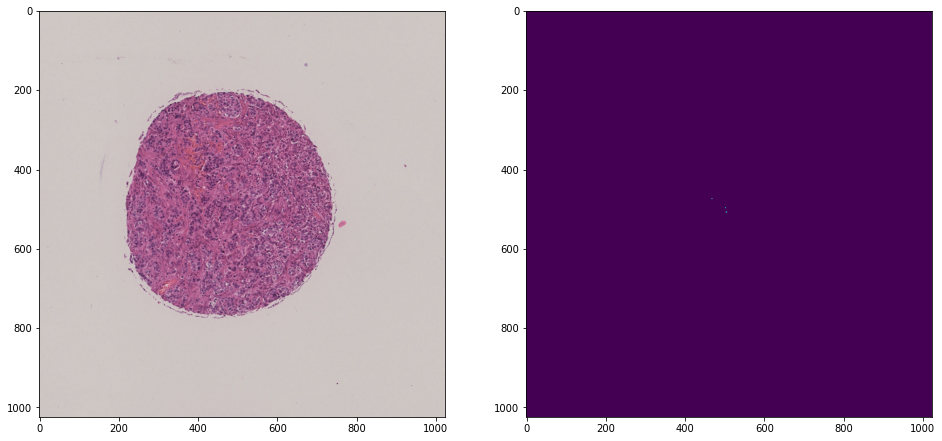

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.8 s, sys: 11.3 s, total: 45.1 s
Wall time: 47.8 s


In [61]:
%%time
index += 1
config.update(dict(addresses=[(18, 17.5), (22, 21.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


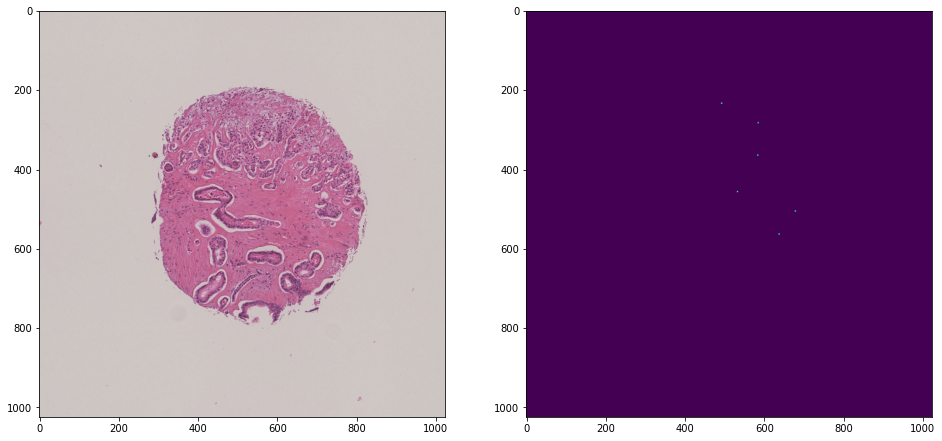

img: 0.02 GB
img: 0.07 GB


In [62]:
##### %%time
index += 1
config.update(dict(addresses=[(21, 17.5), (25, 21.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


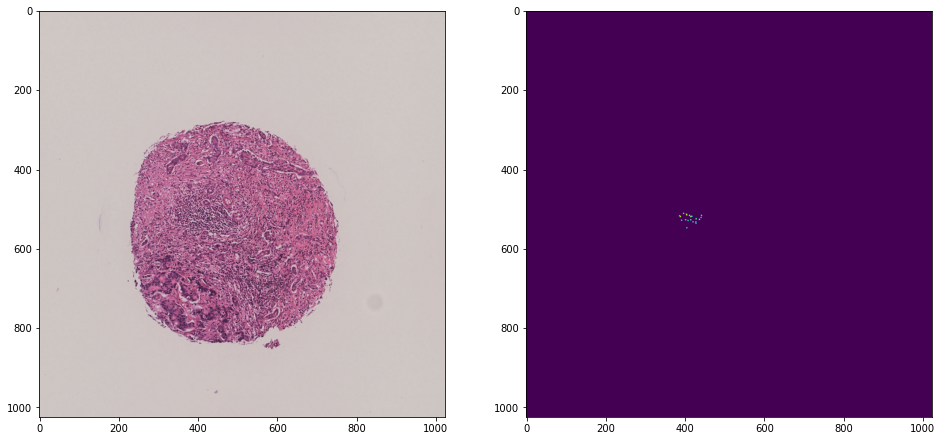

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 6.05 s, total: 40.5 s
Wall time: 41 s


In [63]:
%%time
index += 1
config.update(dict(addresses=[(24.5, 17.5), (28.5, 21.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


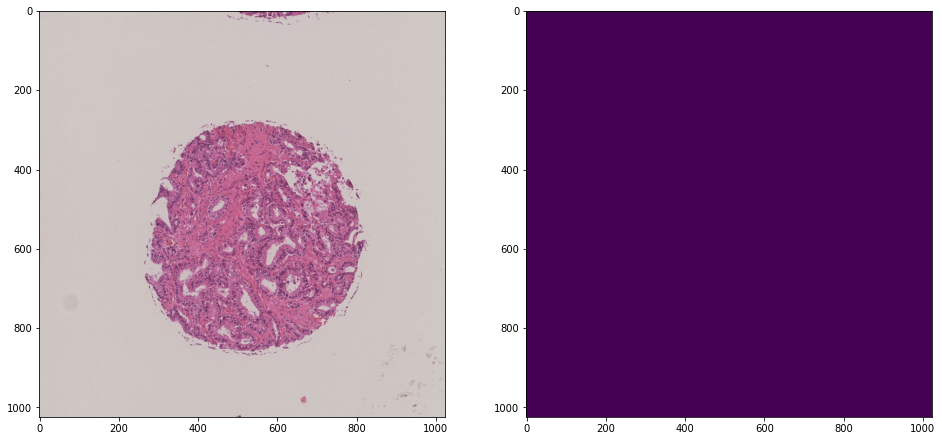

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 7.17 s, total: 41.1 s
Wall time: 41.6 s


In [64]:
%%time
index += 1
config.update(dict(addresses=[(27.5, 17.5), (31.5, 21.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
7行目

CPU times: user 7.65 s, sys: 5.66 s, total: 13.3 s
Wall time: 13.4 s


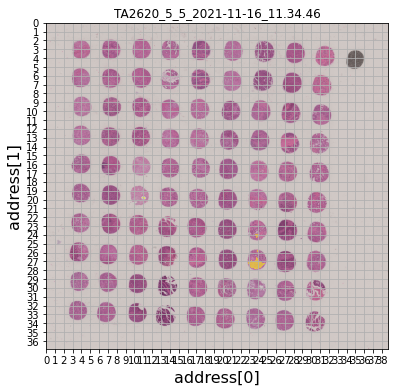

In [65]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


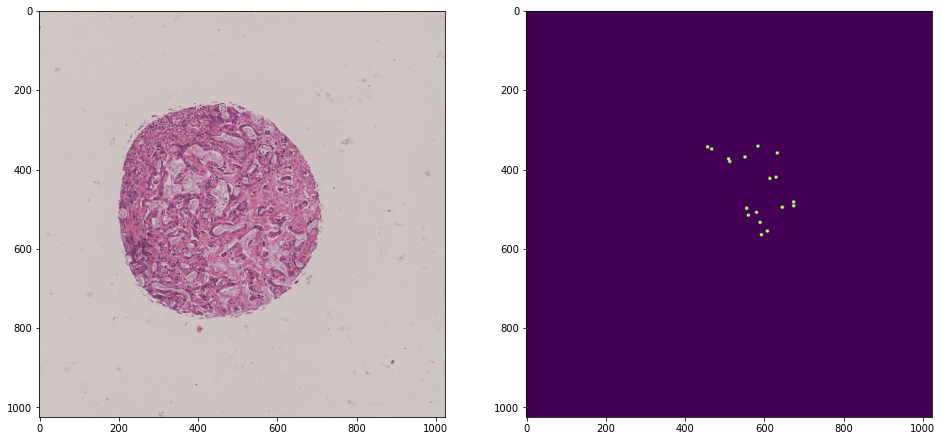

img: 0.02 GB
img: 0.07 GB
CPU times: user 38.7 s, sys: 10.9 s, total: 49.6 s
Wall time: 1min 2s


In [66]:
%%time
index += 1
config.update(dict(addresses=[(2, 20), (6, 24)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


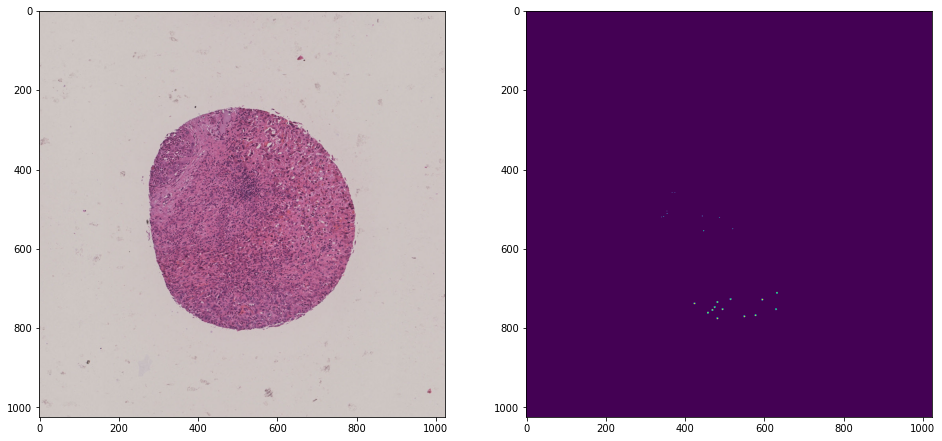

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 11 s, total: 45.4 s
Wall time: 46 s


In [67]:
%%time
index += 1
config.update(dict(addresses=[(5, 20), (9, 24)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


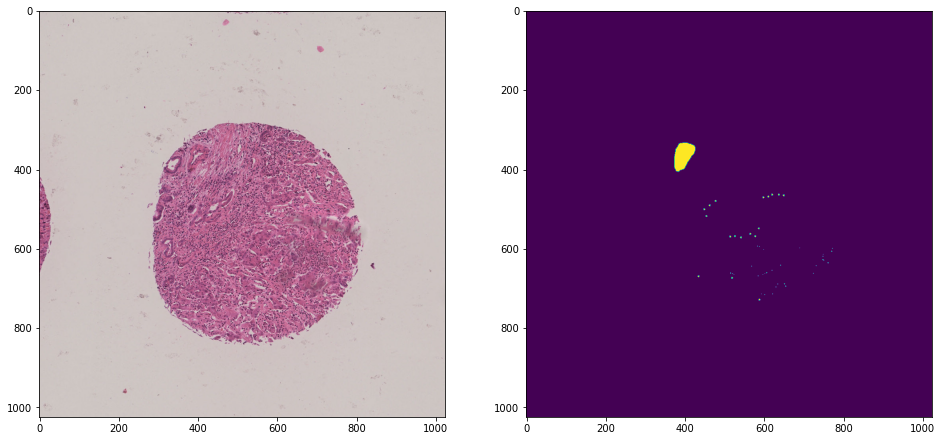

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 9.08 s, total: 43.7 s
Wall time: 44.2 s


In [68]:
%%time
index += 1
config.update(dict(addresses=[(8, 20), (12, 24)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


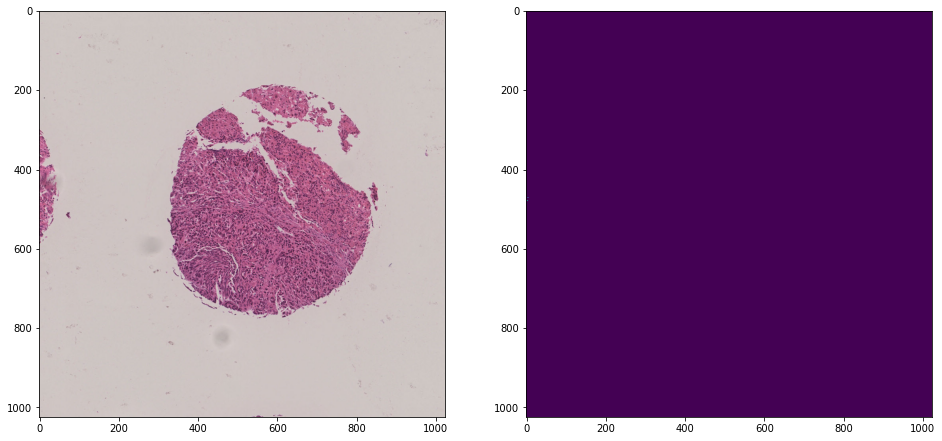

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 7.93 s, total: 42.2 s
Wall time: 43.9 s


In [69]:
%%time
index += 1
config.update(dict(addresses=[(11, 20.5), (15, 24.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


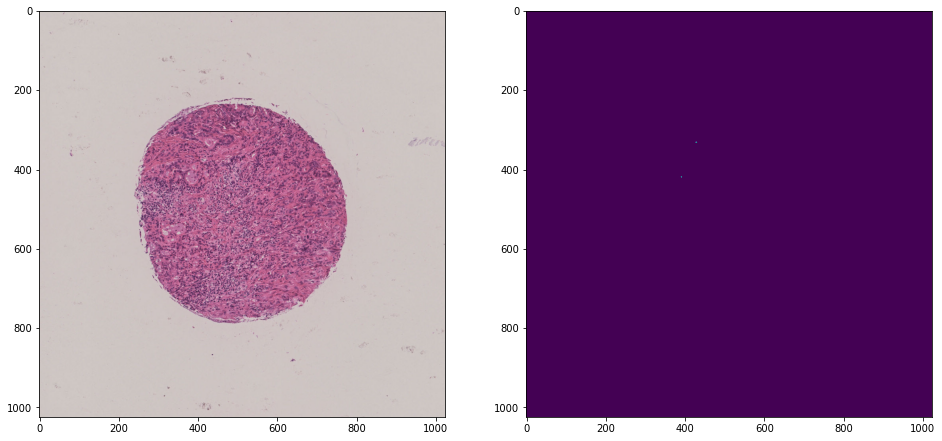

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.8 s, sys: 11.6 s, total: 46.4 s
Wall time: 47.1 s


In [70]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 20.5), (18.5, 24.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


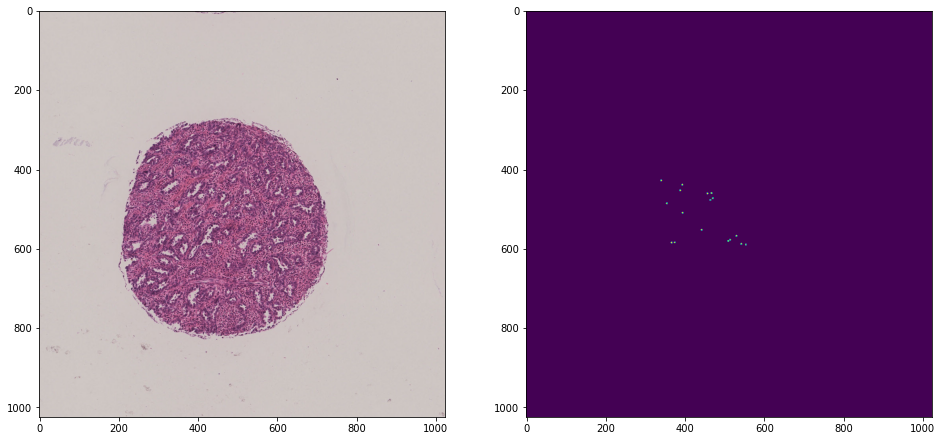

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.8 s, sys: 16.3 s, total: 51.1 s
Wall time: 51.8 s


In [71]:
%%time
index += 1
config.update(dict(addresses=[(18, 20.5), (22, 24.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


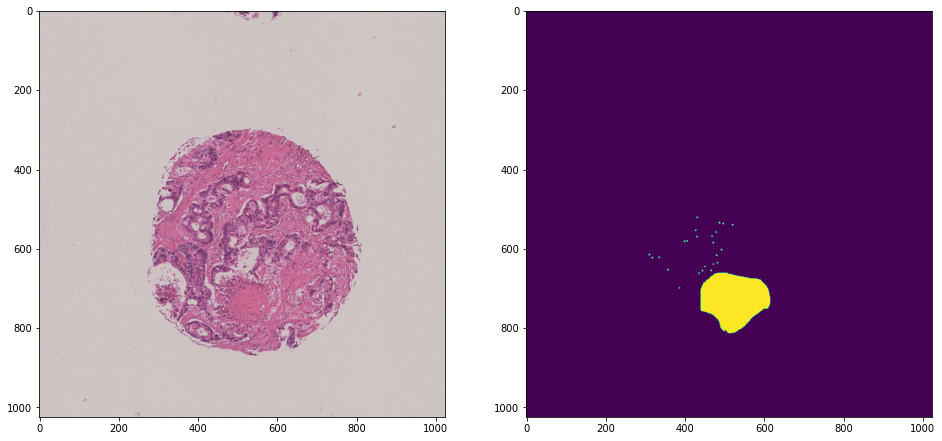

img: 0.02 GB
img: 0.07 GB
CPU times: user 35.2 s, sys: 17.2 s, total: 52.4 s
Wall time: 52.9 s


In [72]:
%%time
index += 1
config.update(dict(addresses=[(21, 20.5), (25, 24.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


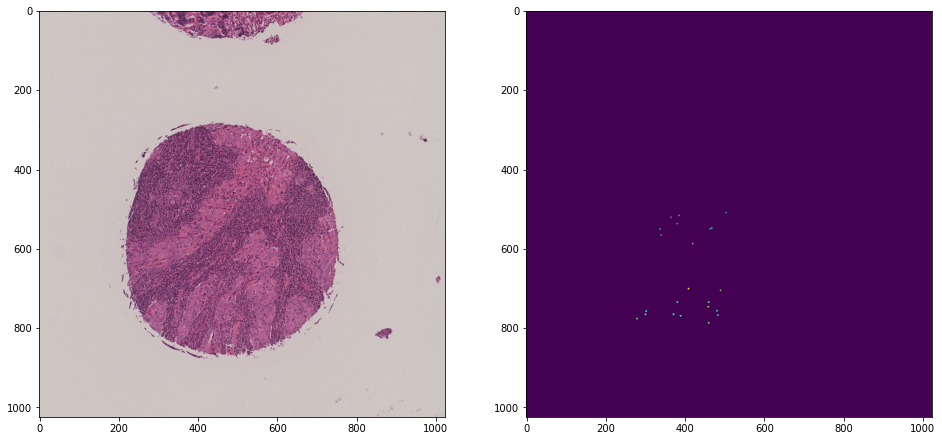

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.8 s, sys: 14.4 s, total: 49.2 s
Wall time: 49.9 s


In [73]:
%%time
index += 1
config.update(dict(addresses=[(24.5, 20.5), (28.5, 24.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


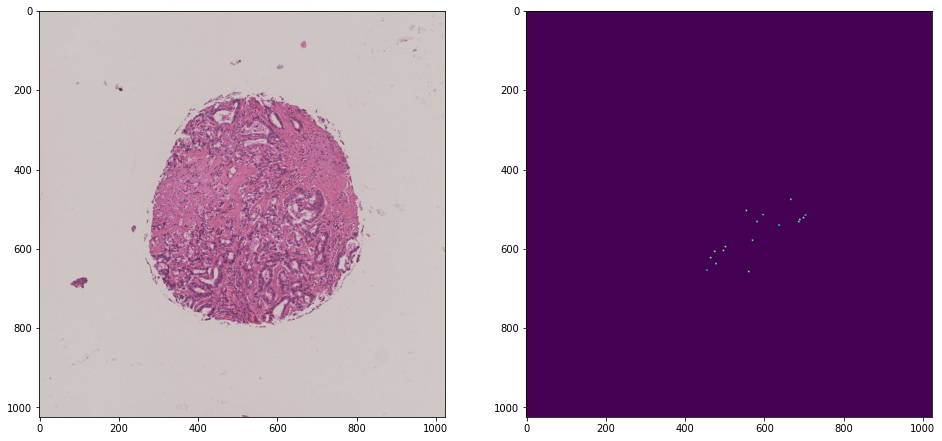

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.1 s, sys: 11 s, total: 45.1 s
Wall time: 47.7 s


In [74]:
%%time
index += 1
config.update(dict(addresses=[(27.5, 21), (31.5, 25)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
8行目

CPU times: user 7.86 s, sys: 5.94 s, total: 13.8 s
Wall time: 13.9 s


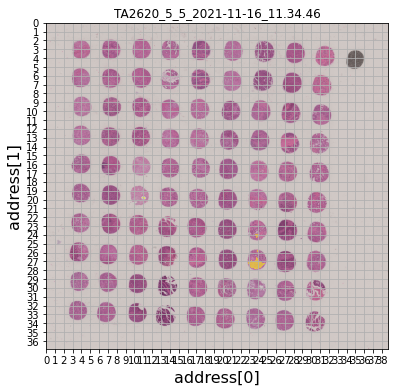

In [75]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


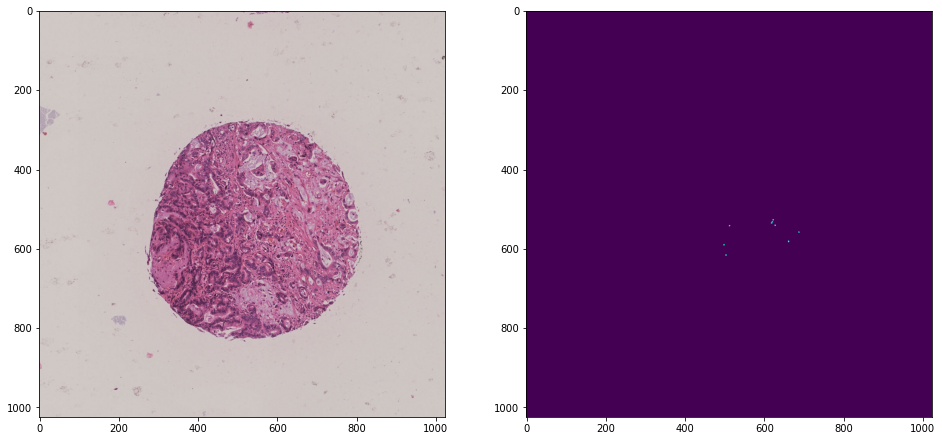

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 15.2 s, total: 49.9 s
Wall time: 57.3 s


In [76]:
%%time
index += 1
config.update(dict(addresses=[(1.5, 23), (5.5, 27)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


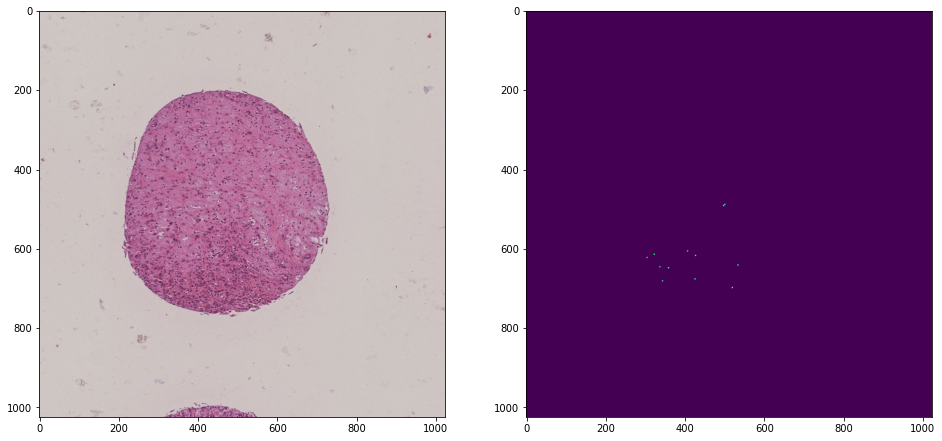

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 13.1 s, total: 47.3 s
Wall time: 49.8 s


In [77]:
%%time
index += 1
config.update(dict(addresses=[(5, 23.5), (9, 27.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


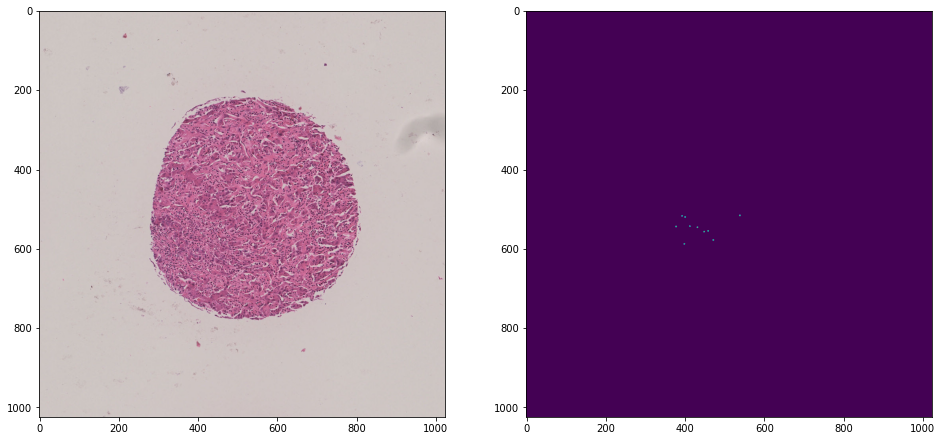

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.5 s, sys: 19.7 s, total: 54.2 s
Wall time: 54.6 s


In [78]:
%%time
index += 1
config.update(dict(addresses=[(8, 23.5), (12, 27.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


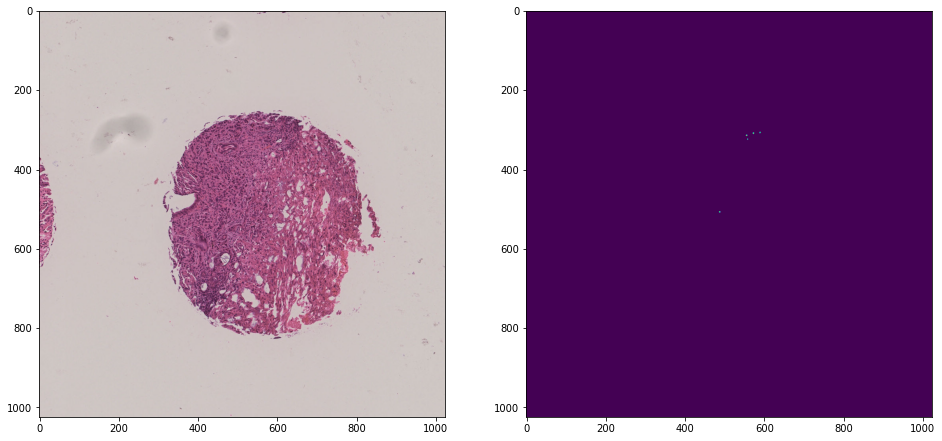

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.2 s, sys: 7.73 s, total: 41.9 s
Wall time: 42 s


In [79]:
%%time
index += 1
config.update(dict(addresses=[(11, 23.5), (15, 27.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


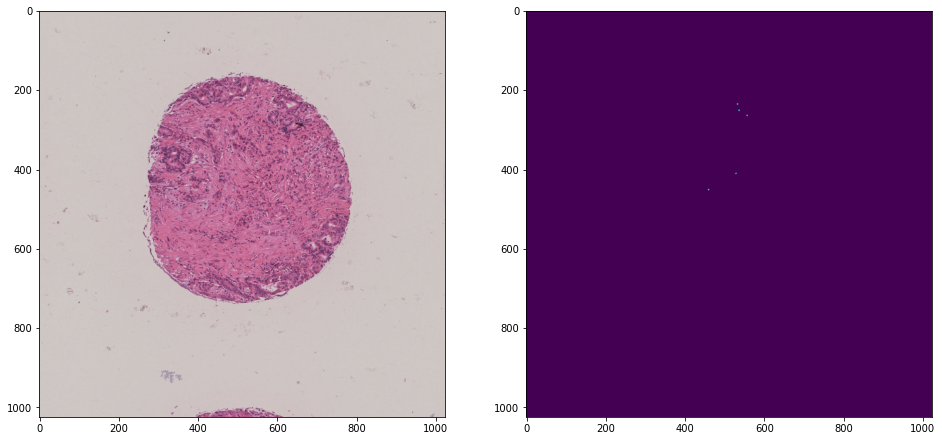

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 9.36 s, total: 43.8 s
Wall time: 45 s


In [80]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 24), (18.5, 28)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


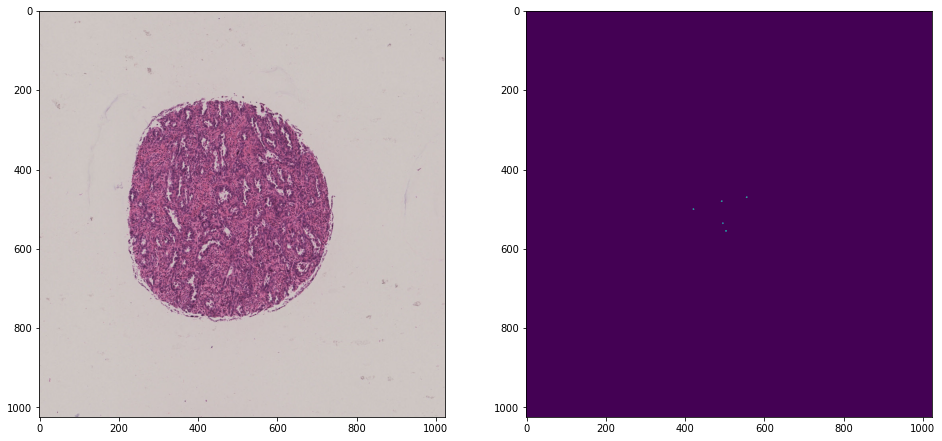

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.4 s, sys: 9.65 s, total: 44.1 s
Wall time: 44.2 s


In [81]:
%%time
index += 1
config.update(dict(addresses=[(18, 24), (22, 28)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


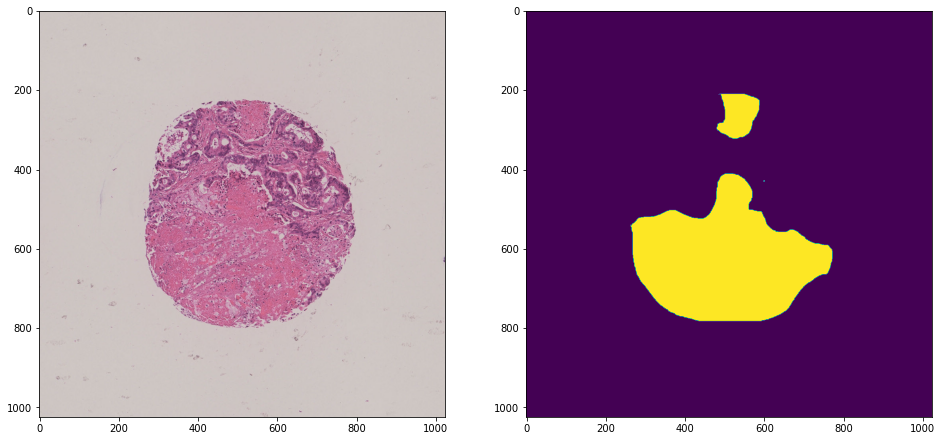

img: 0.02 GB
img: 0.07 GB
CPU times: user 39.7 s, sys: 10.1 s, total: 49.8 s
Wall time: 49.8 s


In [82]:
%%time
index += 1
config.update(dict(addresses=[(21, 24), (25, 28)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


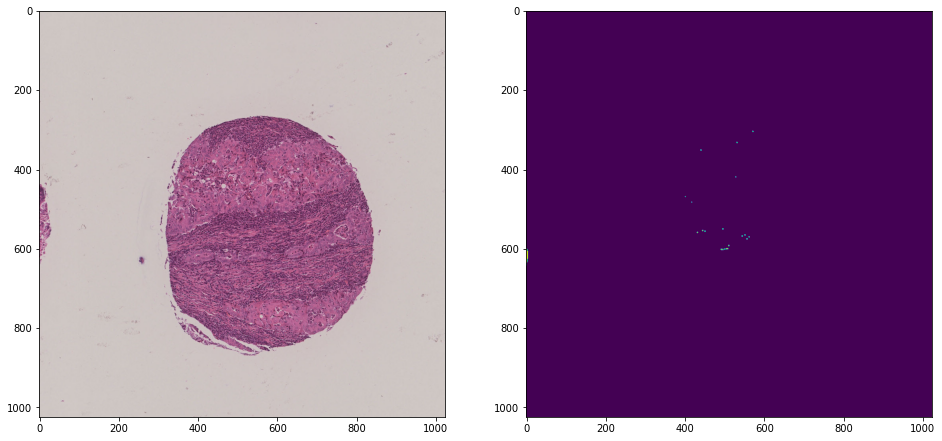

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 13.8 s, total: 48.4 s
Wall time: 48.7 s


In [83]:
%%time
index += 1
config.update(dict(addresses=[(24, 24), (28, 28)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


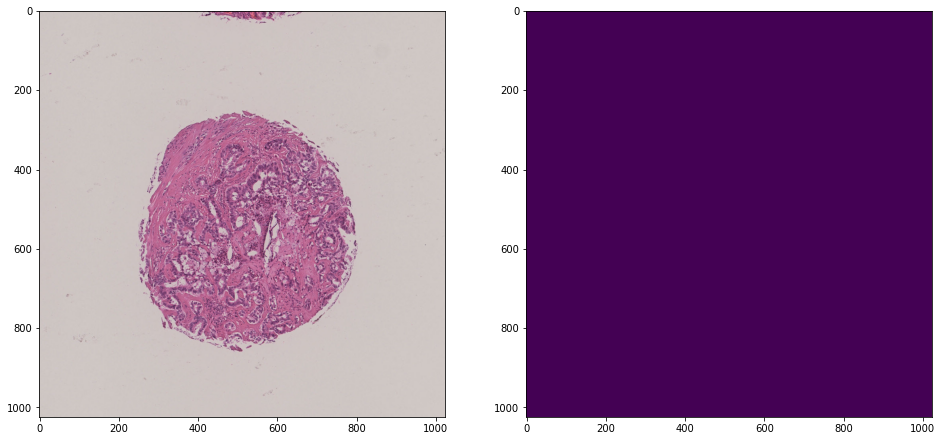

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.2 s, sys: 4.58 s, total: 38.8 s
Wall time: 38.8 s


In [84]:
%%time
index += 1
config.update(dict(addresses=[(27.5, 24), (31.5, 28)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
9行目

CPU times: user 7.83 s, sys: 5.26 s, total: 13.1 s
Wall time: 13.2 s


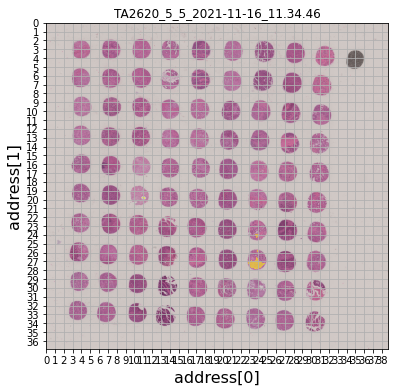

In [85]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


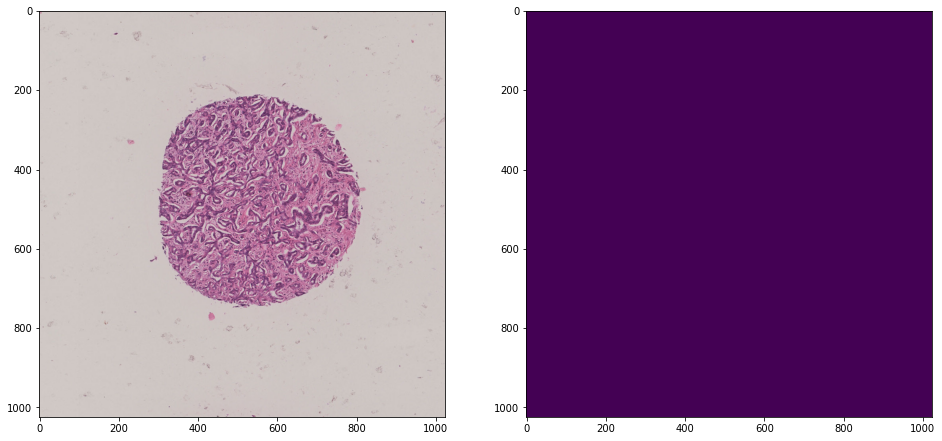

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.6 s, sys: 13.6 s, total: 47.2 s
Wall time: 47.5 s


In [86]:
%%time
index += 1
config.update(dict(addresses=[(1.5, 26.5), (5.5, 30.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


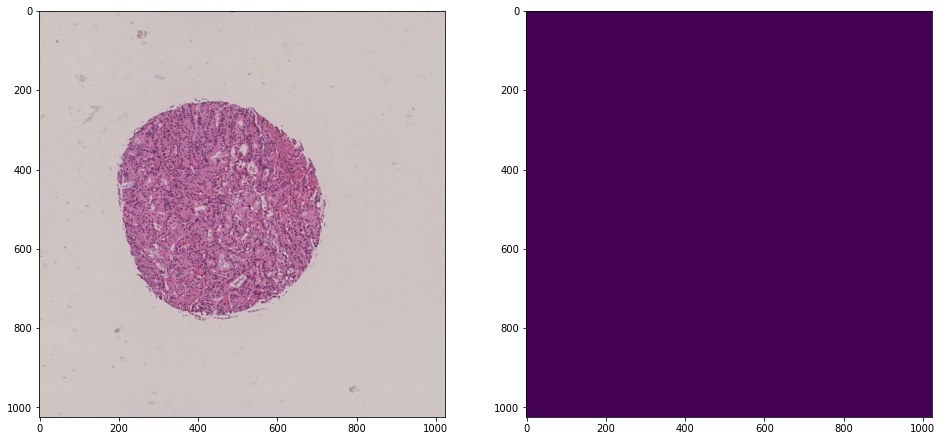

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 4.6 s, total: 38.5 s
Wall time: 38.5 s


In [87]:
%%time
index += 1
config.update(dict(addresses=[(5, 26.5), (9, 30.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


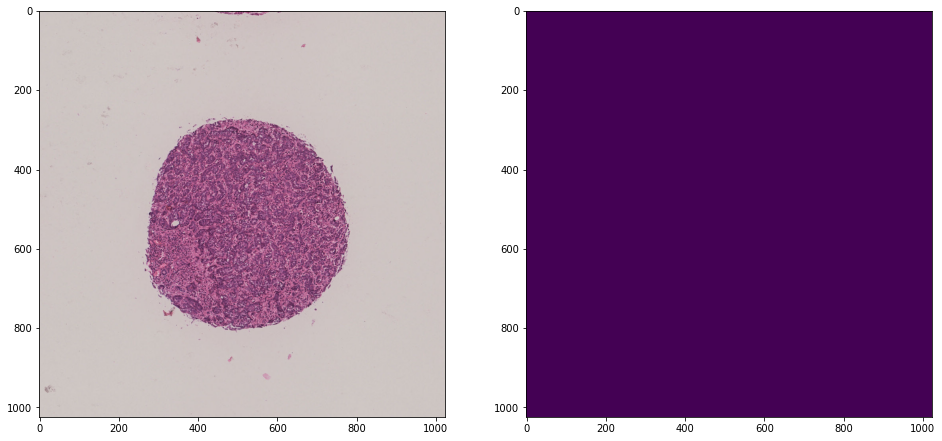

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 4.48 s, total: 38.7 s
Wall time: 38.7 s


In [88]:
%%time
index += 1
config.update(dict(addresses=[(8, 26.5), (12, 30.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


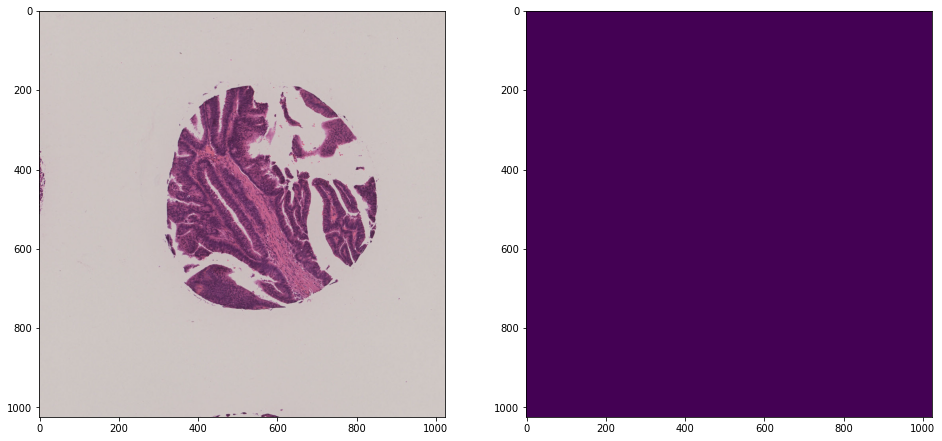

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 5.66 s, total: 39.6 s
Wall time: 43.1 s


In [89]:
%%time
index += 1
config.update(dict(addresses=[(11, 27), (15, 31)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


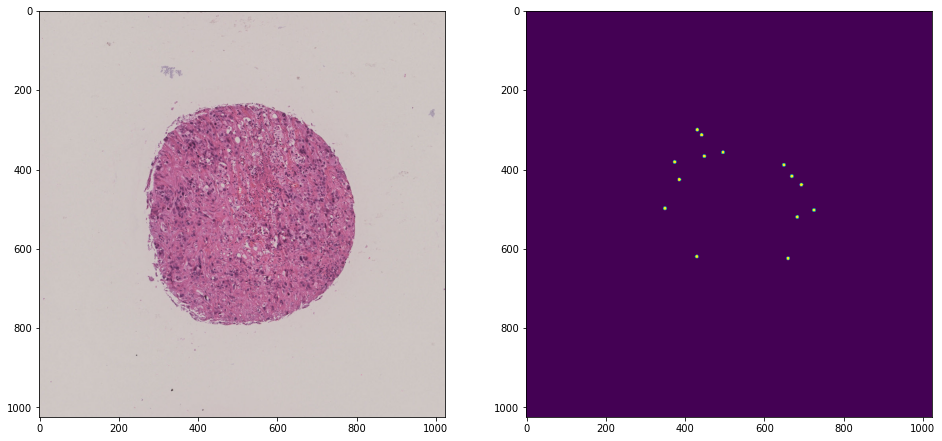

img: 0.02 GB
img: 0.07 GB
CPU times: user 36.9 s, sys: 5.51 s, total: 42.4 s
Wall time: 42.3 s


In [90]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 27), (18.5, 31)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


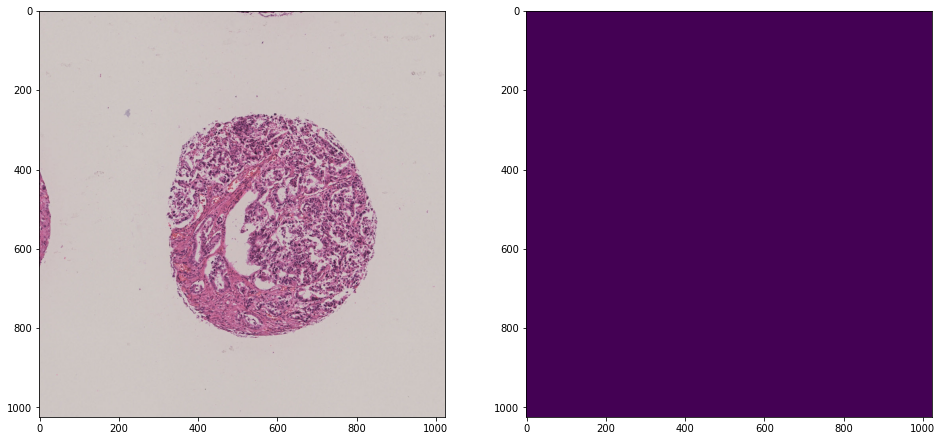

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.7 s, sys: 4.08 s, total: 37.8 s
Wall time: 37.7 s


In [91]:
%%time
index += 1
config.update(dict(addresses=[(17.5, 27), (21.5, 31)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


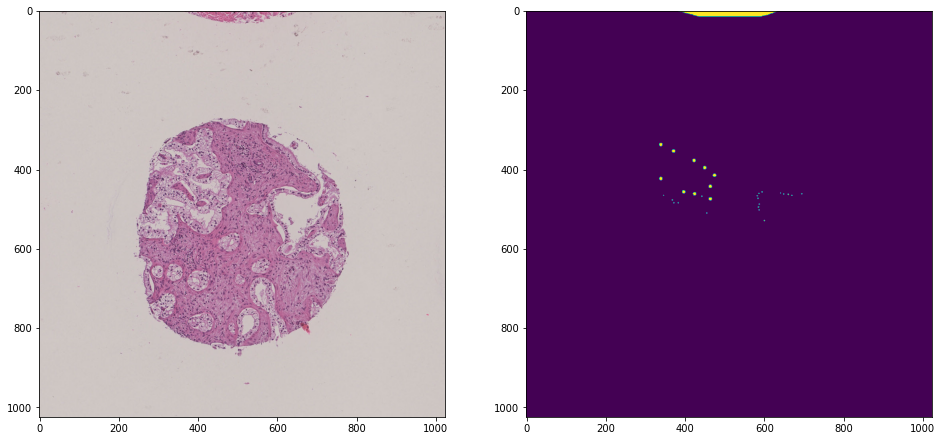

img: 0.02 GB
img: 0.07 GB
CPU times: user 36 s, sys: 4.55 s, total: 40.6 s
Wall time: 40.7 s


In [92]:
%%time
index += 1
config.update(dict(addresses=[(21, 27), (25, 31)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


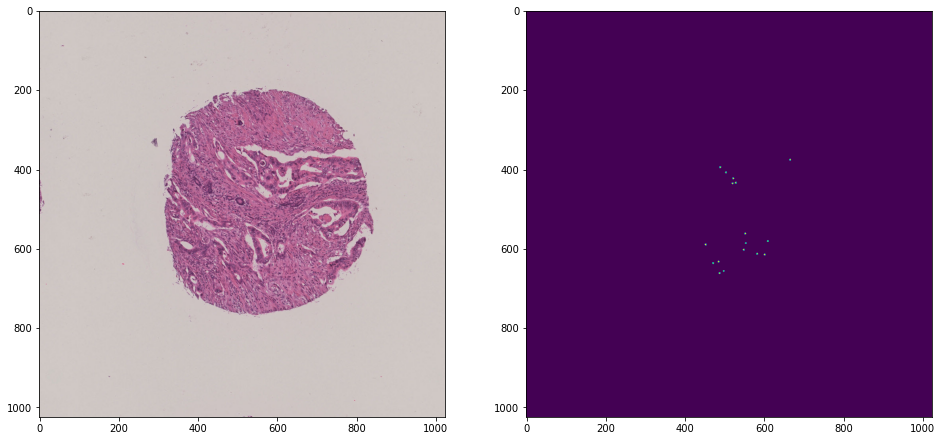

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.7 s, sys: 12.9 s, total: 47.6 s
Wall time: 50.1 s


In [93]:
%%time
index += 1
config.update(dict(addresses=[(24, 27.5), (28, 31.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


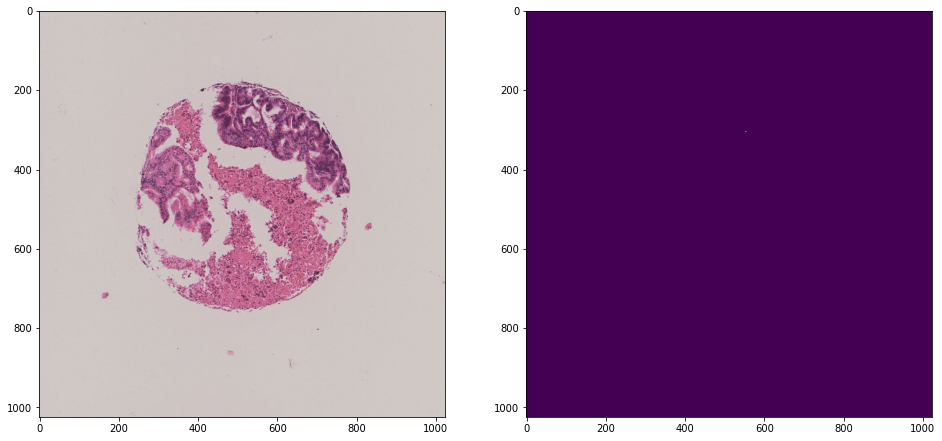

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.9 s, sys: 5.32 s, total: 39.3 s
Wall time: 39.2 s


In [94]:
%%time
index += 1
config.update(dict(addresses=[(27.5, 27.5), (31.5, 31.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

---
10行目

CPU times: user 7.56 s, sys: 6.7 s, total: 14.3 s
Wall time: 14.3 s


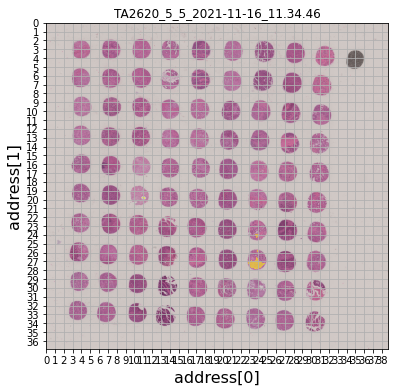

In [95]:
%%time
ndpi = load_ndpi(ndp_dir / (str(img_name) + ".ndpi"))
ndpa = load_ndpa(ndp_dir / (str(img_name) + ".ndpi.ndpa"))

config = generate_config(
    level=init_level,
    tile_size=size,
)
dz = DeepZoom(ndpi, ndpa, tile_size=config["tile_size"])
_show_guide(dz, level=config["level"], title=img_name)

img: 0.00 GB


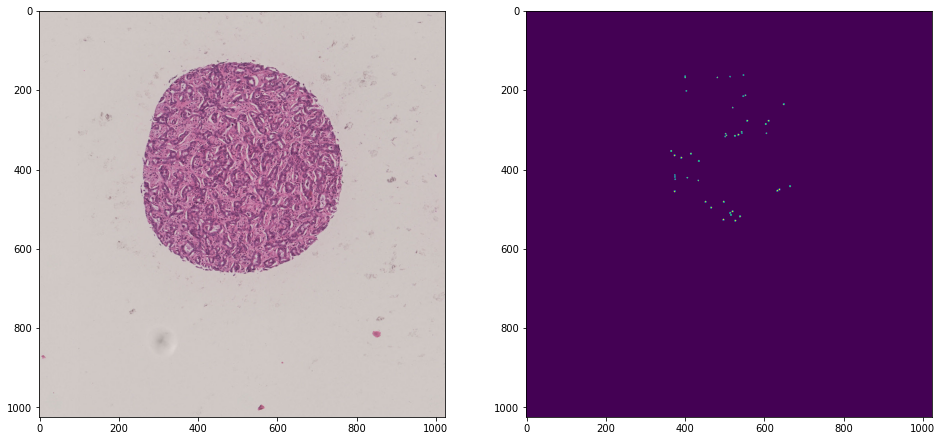

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.6 s, sys: 5.25 s, total: 39.9 s
Wall time: 51.5 s


In [96]:
%%time
index += 1
config.update(dict(addresses=[(1.5, 30), (5.5, 34)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


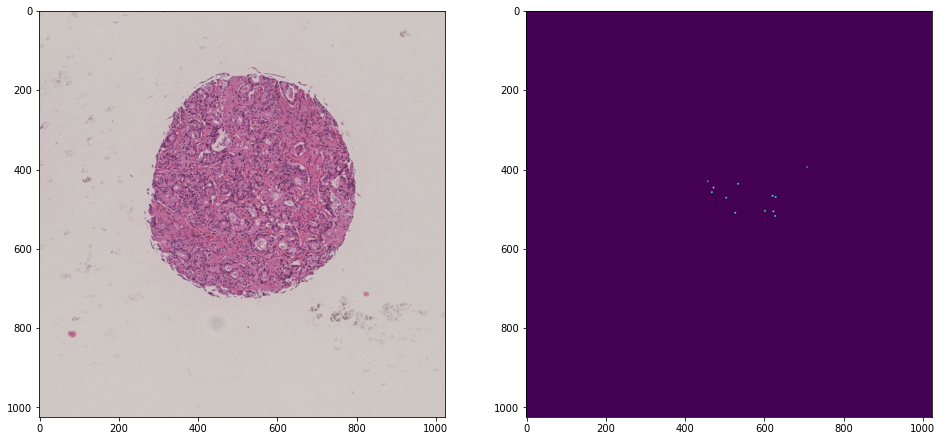

img: 0.02 GB
img: 0.07 GB
CPU times: user 34 s, sys: 4.33 s, total: 38.3 s
Wall time: 38.2 s


In [97]:
%%time
index += 1
config.update(dict(addresses=[(4.5, 30), (8.5, 34)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


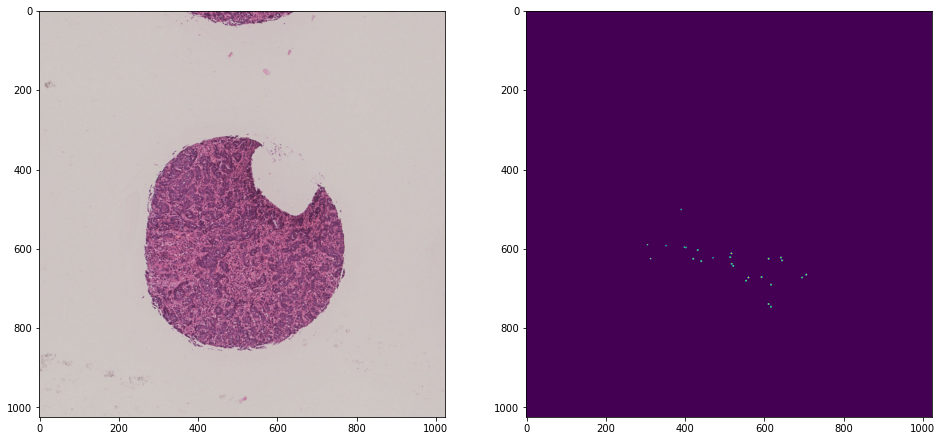

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.3 s, sys: 12.8 s, total: 47.1 s
Wall time: 47.1 s


In [98]:
%%time
index += 1
config.update(dict(addresses=[(8, 29.5), (12, 33.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


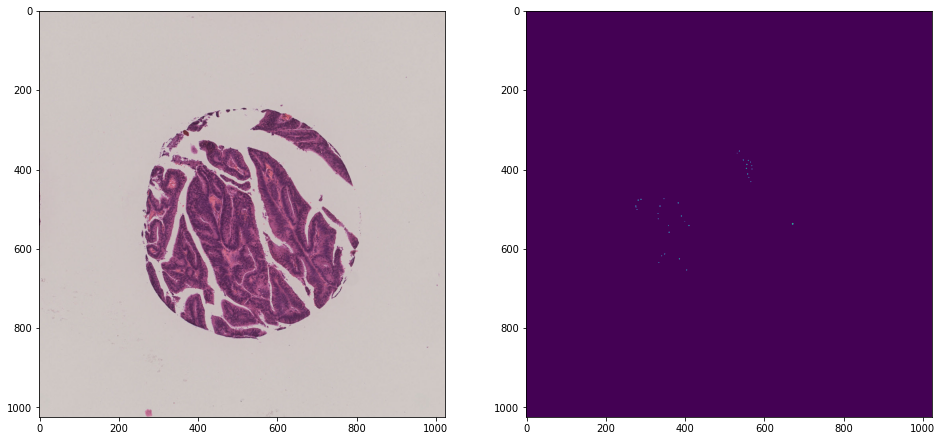

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.8 s, sys: 11.8 s, total: 45.6 s
Wall time: 45.7 s


In [99]:
%%time
index += 1
config.update(dict(addresses=[(11, 30), (15, 34)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


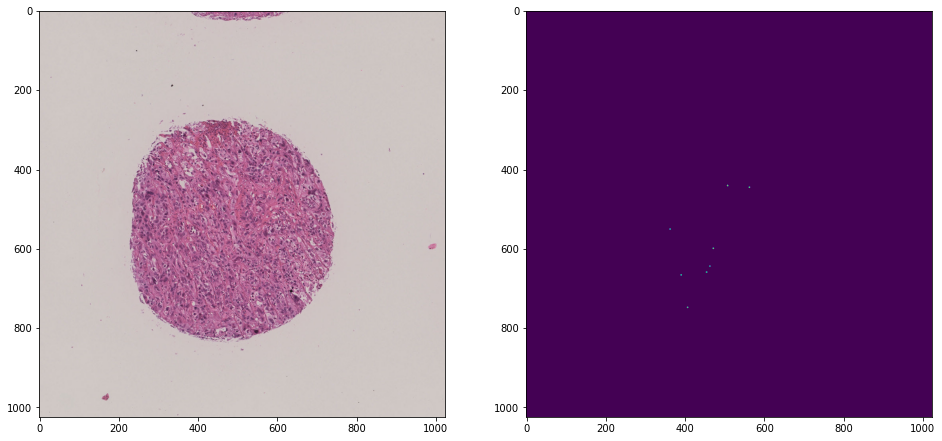

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.8 s, sys: 11.6 s, total: 45.4 s
Wall time: 45.5 s


In [100]:
%%time
index += 1
config.update(dict(addresses=[(14.5, 30), (18.5, 34)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


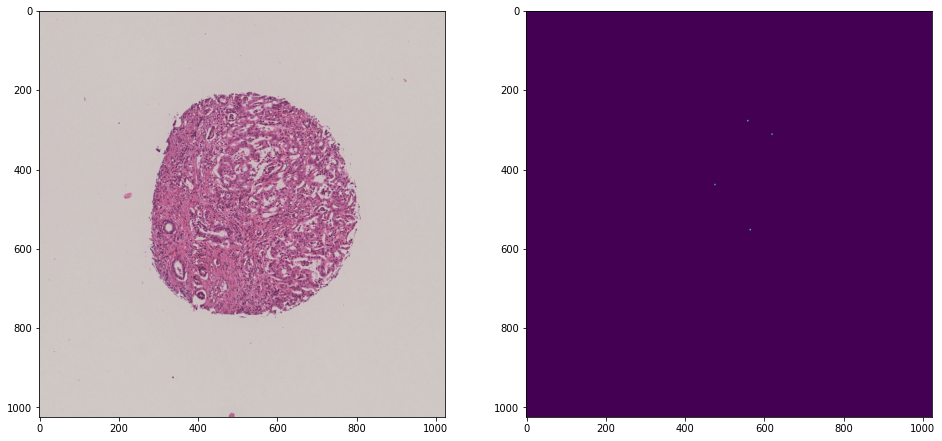

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.6 s, sys: 3.96 s, total: 37.5 s
Wall time: 38.8 s


In [101]:
%%time
index += 1
config.update(dict(addresses=[(17.5, 30.5), (21.5, 34.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


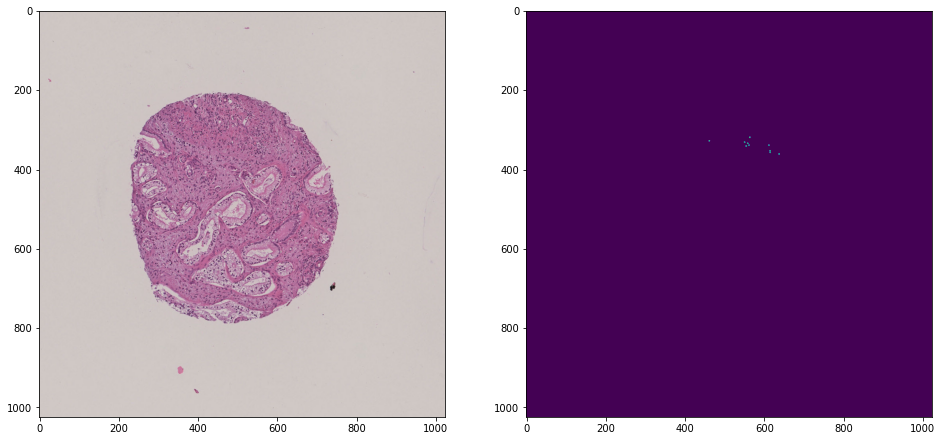

img: 0.02 GB
img: 0.07 GB
CPU times: user 33.7 s, sys: 5.5 s, total: 39.2 s
Wall time: 39.2 s


In [102]:
%%time
index += 1
config.update(dict(addresses=[(21, 30.5), (25, 34.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


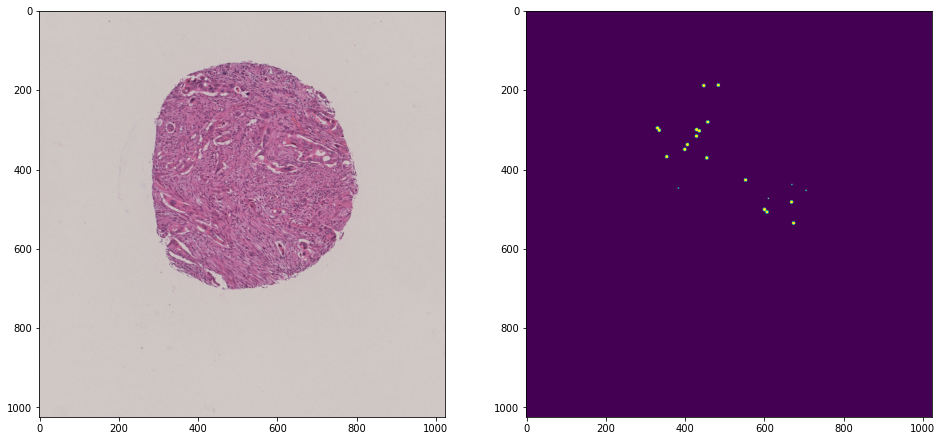

img: 0.02 GB
img: 0.07 GB
CPU times: user 38.2 s, sys: 12.5 s, total: 50.7 s
Wall time: 52.3 s


In [103]:
%%time
index += 1
config.update(dict(addresses=[(24, 31), (28, 35)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()

img: 0.00 GB


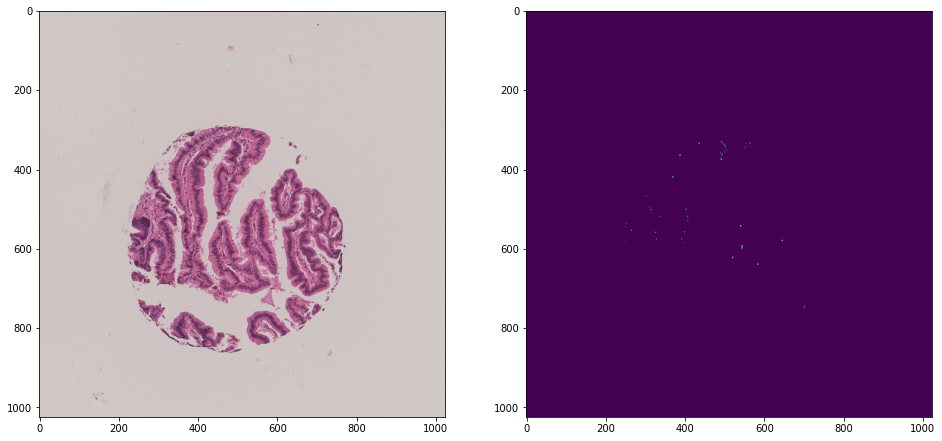

img: 0.02 GB
img: 0.07 GB
CPU times: user 34.5 s, sys: 11.2 s, total: 45.7 s
Wall time: 45.8 s


In [104]:
%%time
index += 1
config.update(dict(addresses=[(27.5, 30.5), (31.5, 34.5)]))

for i in range(len(target_levels)):
    # make directory to save.
    output_dir = output_dir_parent / f"{target_levels[i]}/slide"
    output_dir.mkdir(parents=True, exist_ok=True)

    # crop
    cropped, masks = _crop(dz, config["addresses"], config["tile_size"],
                     config["level"], target_levels[i], return_mask=True, groupby_mask="title")
    print(f"img: {cropped.nbytes / 1e+9:.2f} GB")
    np.save(output_dir / f"cropped_{index}.npy", cropped)
    np.save(output_dir / f"masks_{index}.npy", masks)

    if i == 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(cropped)
        axes[1].imshow(np.any(list(masks.values()), axis=0))
        plt.show()